# Median filter

The median filter defines an N by N kernel around the pixel, and then gives the pixel the median of the neighboring pixel as the new value.

The median is the middle number of an increasing sorted list.


This type of filter is believed to work well with salt and pepper noise, as it ignores outliers. Let's test this out.

In [1]:
import os
import cv2
import pandas as pd
import matplotlib.pyplot as plt
import time
import numpy as np

In [49]:
Computational_times = {}
average_MSE = {}
average_psnr = {}

In [3]:
image_folder = '/content/original_images'

data = []

for filename in os.listdir(image_folder):
    if filename.endswith(('.png', '.jpg', '.jpeg')):
        img = cv2.imread(os.path.join(image_folder, filename))
        if img is not None:
            gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
            data.append({'filename': filename, 'image': gray_img})

original = pd.DataFrame(data)

In [4]:
def add_salt_pepper_noise(image, prob):
    noisy_image = image.copy()

    num_salt = np.ceil(prob * image.size * 0.5)
    coords = [np.random.randint(0, i - 1, int(num_salt)) for i in image.shape]
    noisy_image[coords[0], coords[1]] = 1

    num_pepper = np.ceil(prob * image.size * 0.5)
    coords = [np.random.randint(0, i - 1, int(num_pepper)) for i in image.shape]
    noisy_image[coords[0], coords[1]] = 0

    return noisy_image

noise_levels = [0.01, 0.08, 0.2]

noisy_data = []

for index, row in original.iterrows():
    for level in noise_levels:
        noisy_img = add_salt_pepper_noise(row['image'], level)
        noisy_data.append({
            'filename': f"{row['filename']}_noise_{level}",
            'image': noisy_img,
            'noise_level': level
        })


salty = pd.DataFrame(noisy_data)

In [50]:
Computational_times["Salt and Pepper"] = []
average_MSE["Salt and Pepper"] = []
average_psnr["Salt and Pepper"] = []

In [51]:
def apply_median_filter(image, ksize=5):
    filtered_image = cv2.medianBlur(image, ksize)
    return filtered_image

start_time = time.time()

filtered_data = []

for index, row in salty.iterrows():
    filtered_img = apply_median_filter(row['image'], ksize=5)
    filtered_data.append({
        'filename': f"{row['filename']}_gaussian_filtered",
        'image': filtered_img,
    })

end_time = time.time()

total_time = end_time - start_time
Computational_times["Salt and Pepper"].append(total_time)
print(f"Total computational time for applying Median filter: {total_time:.4f} seconds")

filtered_images = pd.DataFrame(filtered_data)

Total computational time for applying Median filter: 0.5504 seconds


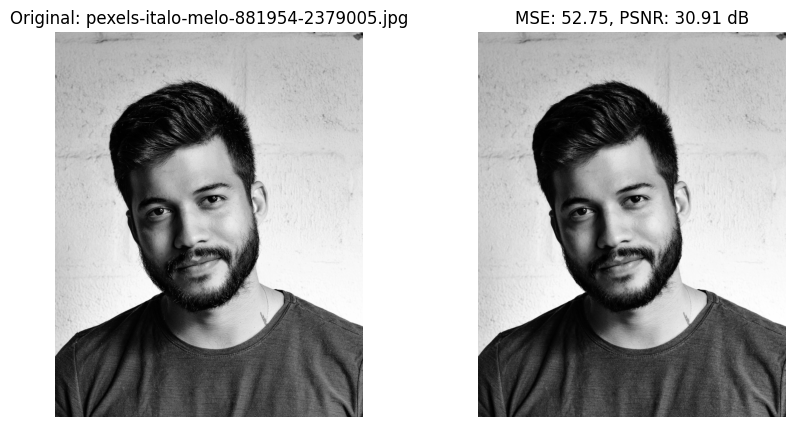

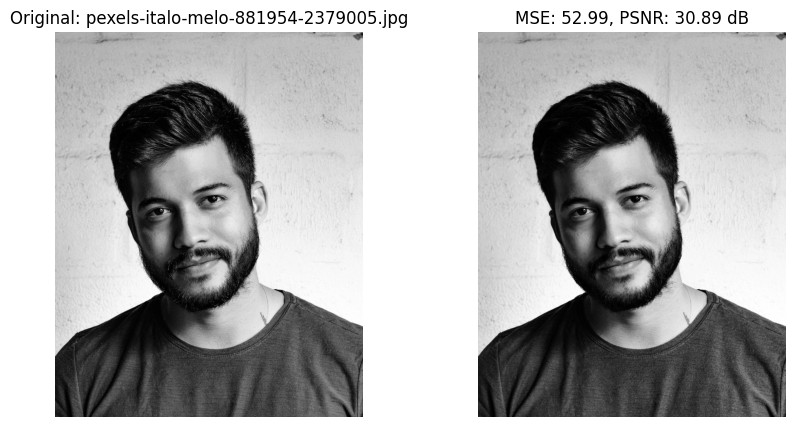

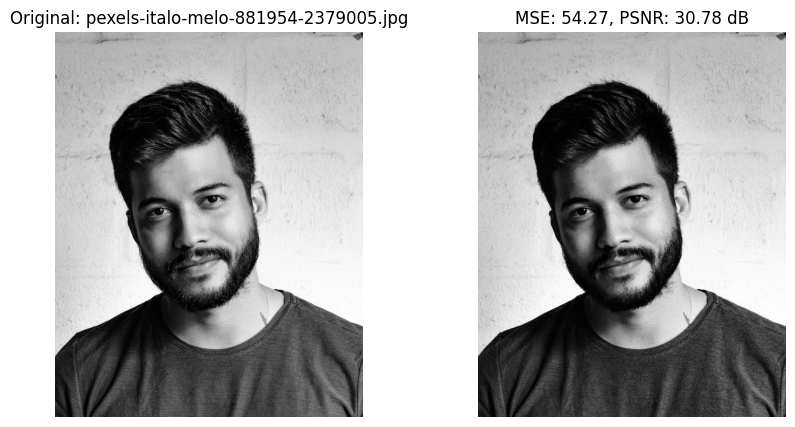

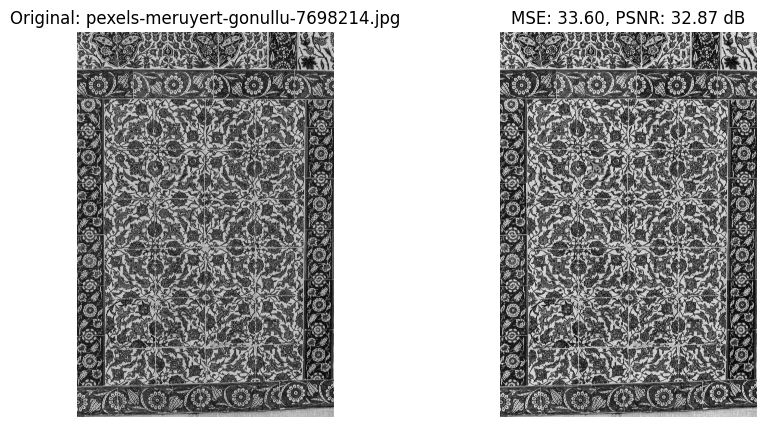

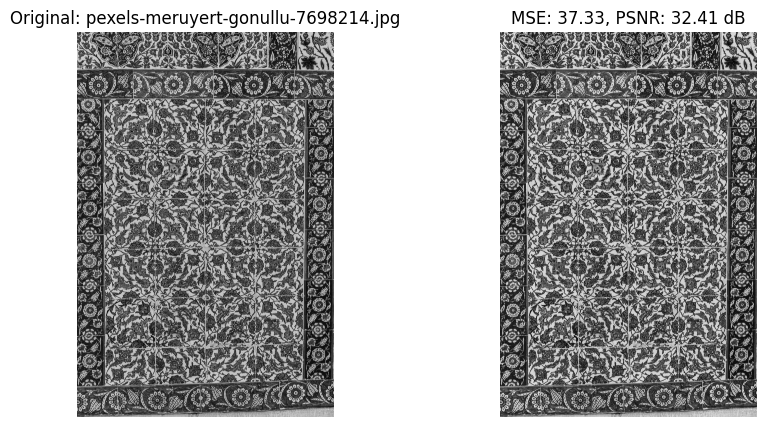

...

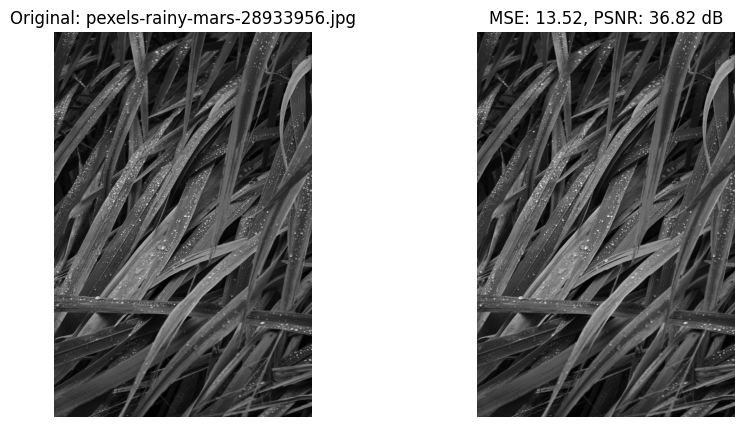

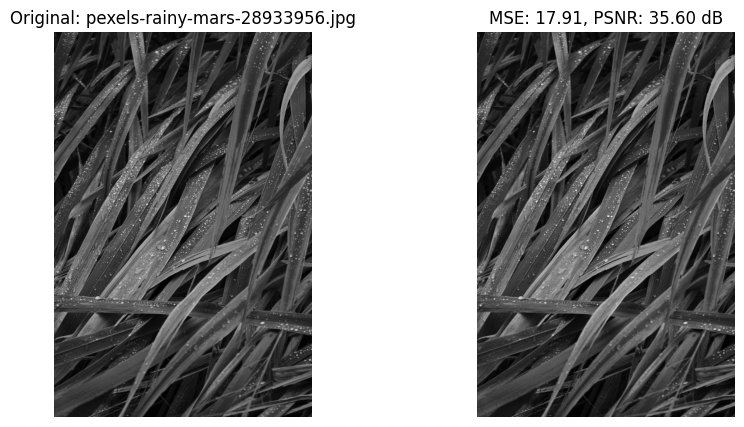

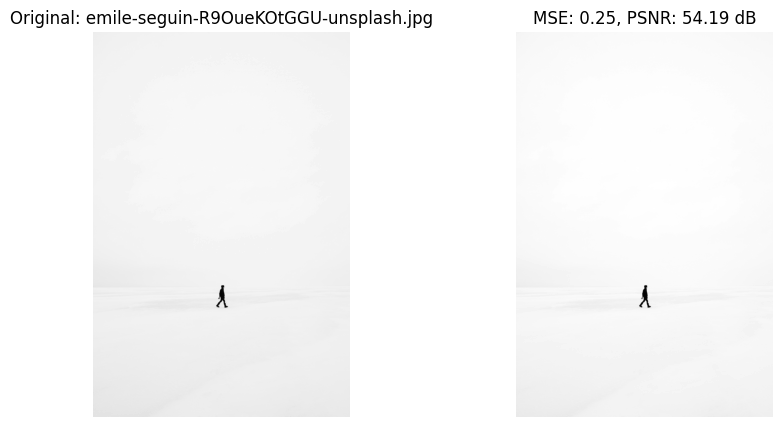

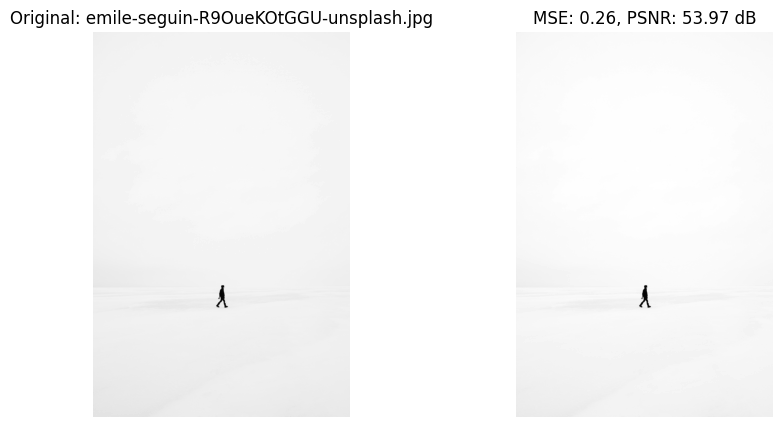

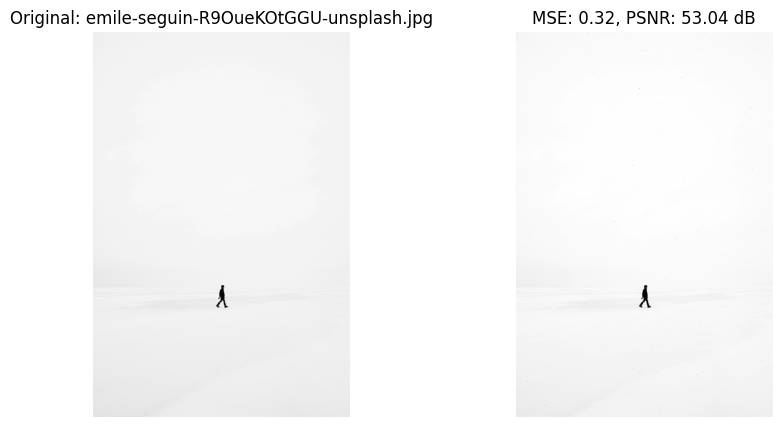

avarage mse = 26.643885121745853
avarage psnr = 38.37561061086456


In [52]:

def calculate_mse(original, filtered):
    return np.mean((original - filtered) ** 2)

def calculate_psnr(mse, max_pixel=255.0):
    return 20 * np.log10(max_pixel) - 10 * np.log10(mse) if mse > 0 else float('inf')

counter = 0
mse_sum = 0
psnr_sum = 0

for index, row in original.iterrows():
    original_img = row['image']

    filtered_img_rows = filtered_images[filtered_images['filename'].str.contains(row['filename'])]

    for _, filtered_row in filtered_img_rows.iterrows():
        filtered_img = filtered_row['image']

        mse = calculate_mse(original_img, filtered_img)
        mse_sum += mse
        psnr = calculate_psnr(mse)
        psnr_sum += psnr

        counter +=1

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title(f"Original: {row['filename']}")
        axes[0].axis('off')

        axes[1].imshow(filtered_img, cmap='gray')
        axes[1].set_title(f"MSE: {mse:.2f}, PSNR: {psnr:.2f} dB")
        axes[1].axis('off')

        plt.show()

avrg_mse = mse_sum/counter
average_MSE["Salt and Pepper"].append(avrg_mse)
print(f"avarage mse = {avrg_mse}")

avrg_psnr = psnr_sum/counter
average_psnr["Salt and Pepper"].append(avrg_psnr)
print(f"avarage psnr = {avrg_psnr}")

The median filter did remarkable on salt and pepper noise. The images look almost identical to the original ones, with a very small value of MSE. even with high levels of noise.

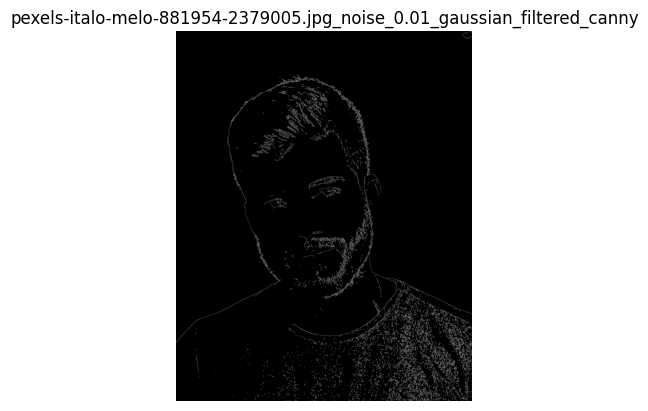

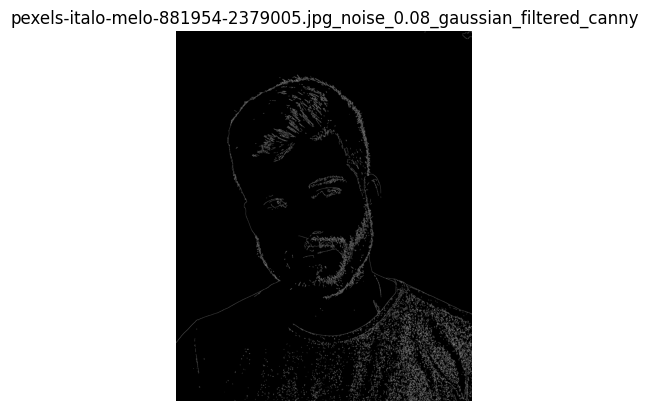

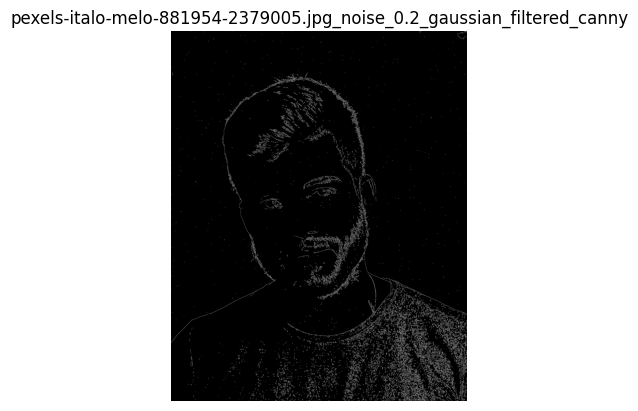

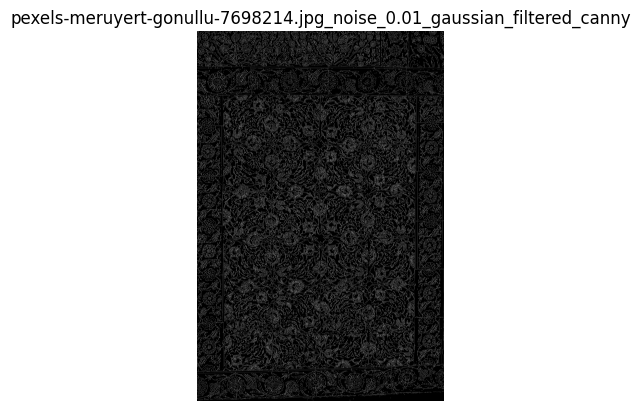

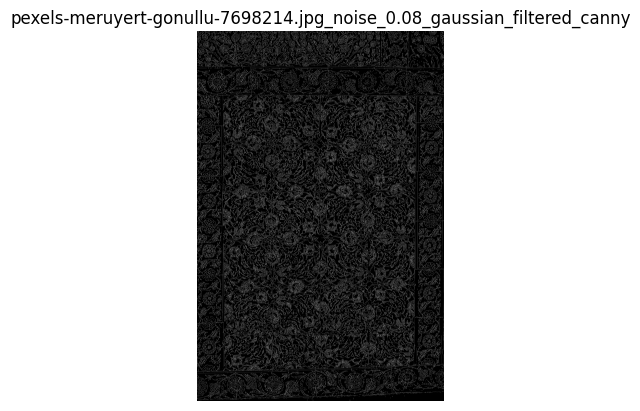

...

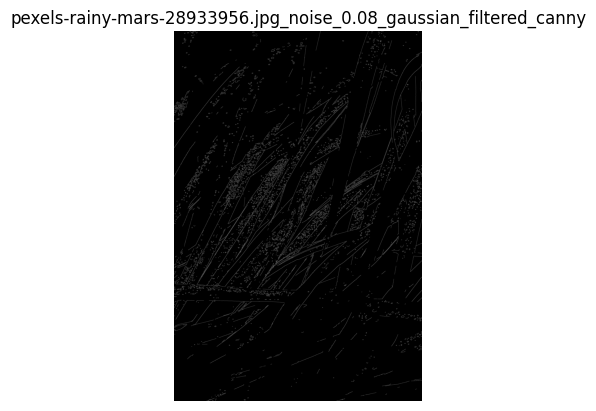

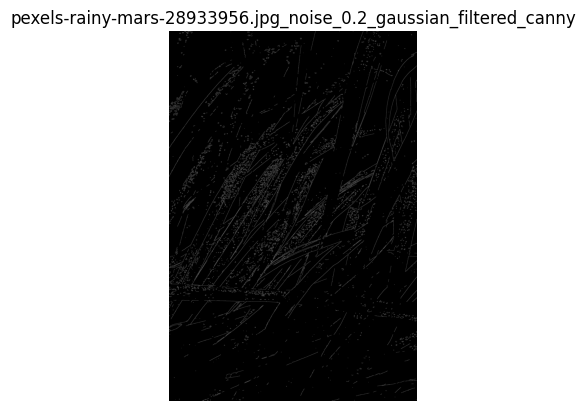

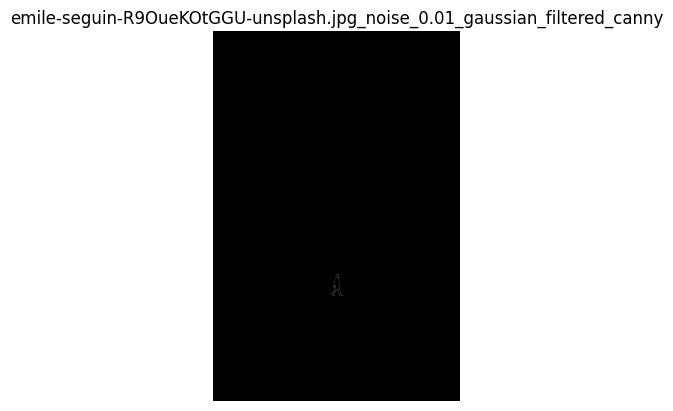

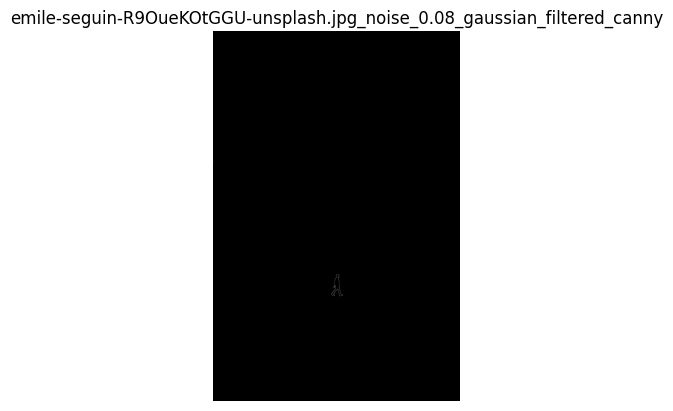

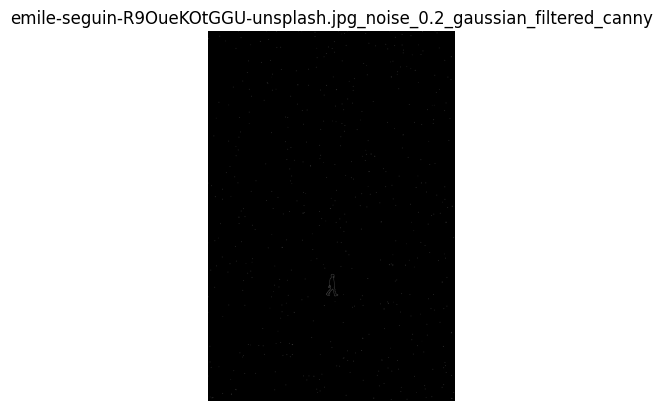

In [11]:
def apply_canny_edge(image, threshold1=100, threshold2=200):
    edges = cv2.Canny(image, threshold1, threshold2)
    return edges

canny_data = []

for index, row in filtered_images.iterrows():
    canny_edges = apply_canny_edge(row['image'], threshold1=100, threshold2=200)
    canny_data.append({
        'filename': f"{row['filename']}_canny",
        'image': canny_edges
    })

canny_edges_df = pd.DataFrame(canny_data)

for index, row in canny_edges_df.iterrows():
    plt.imshow(row['image'], cmap='gray')
    plt.title(row['filename'])
    plt.axis('off')
    plt.show()

Canny was able to perform very good on the images filtered by the Median filter. Almost no noise was detected in the images, and weak edges could still be detected.

Median filter did great in removing outliers and replacing them with a suitable close to original value.

Would a higher kernel do better? Or overdo it so that negative outputs are seen?

In [53]:
start_time = time.time()

filtered_data = []

for index, row in salty.iterrows():
    filtered_img = apply_median_filter(row['image'], ksize=11)
    filtered_data.append({
        'filename': f"{row['filename']}_gaussian_filtered",
        'image': filtered_img,
    })

end_time = time.time()

total_time = end_time - start_time
Computational_times["Salt and Pepper"].append(total_time)
print(f"Total computational time for applying Median filter: {total_time:.4f} seconds")

filtered_images = pd.DataFrame(filtered_data)

Total computational time for applying Median filter: 6.3176 seconds


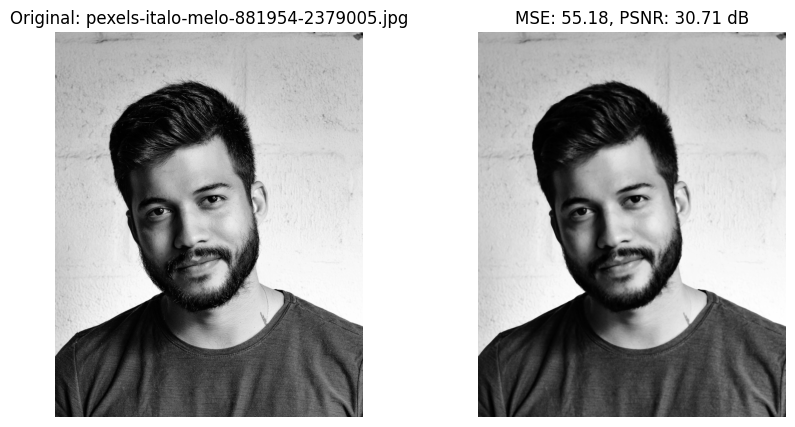

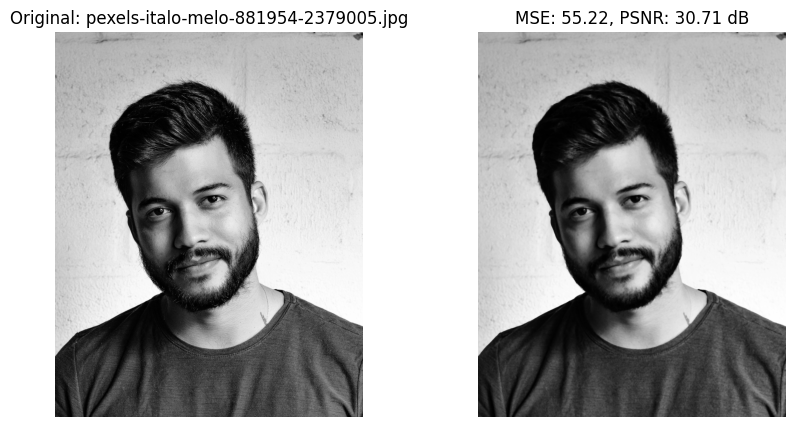

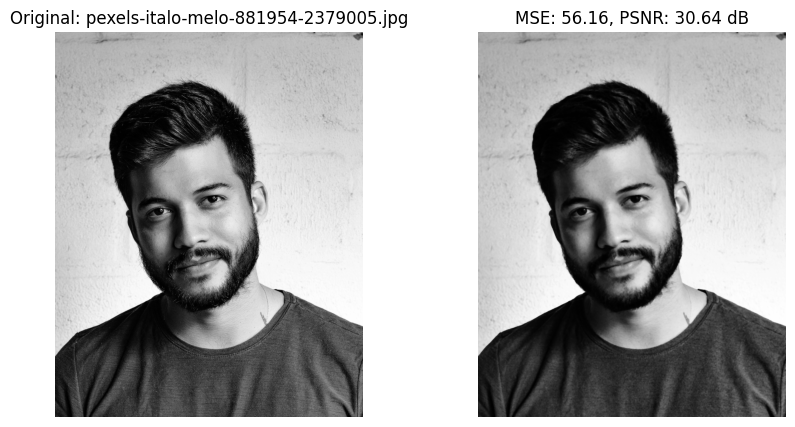

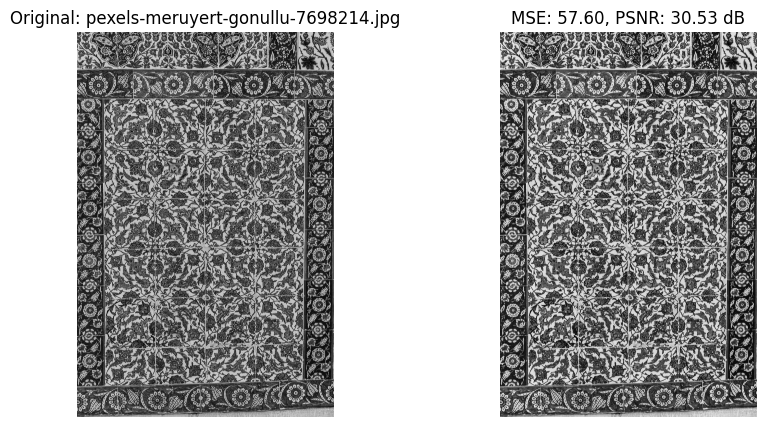

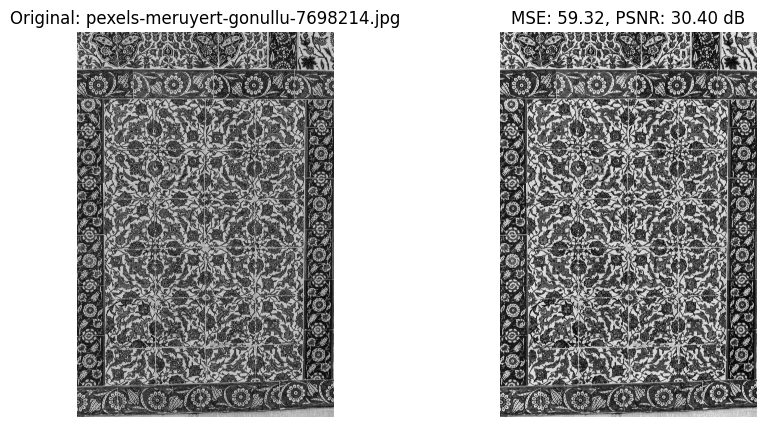

...

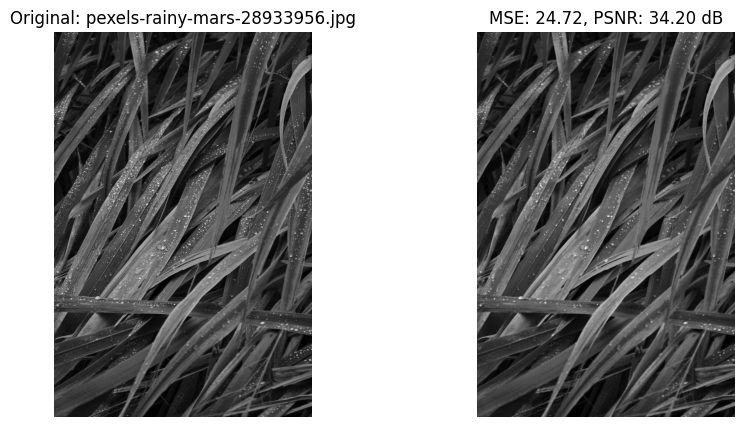

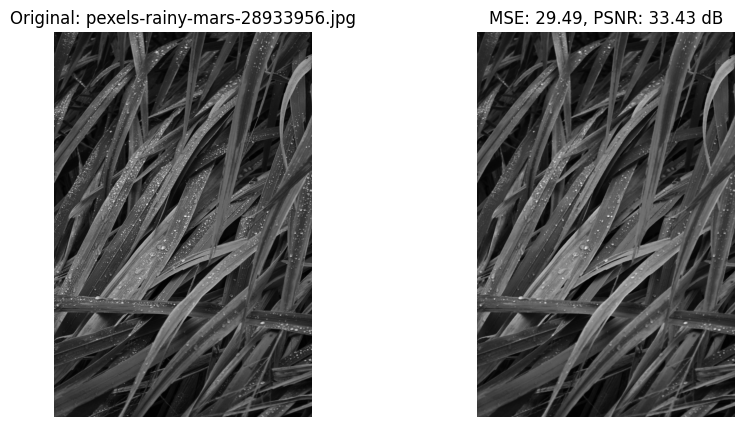

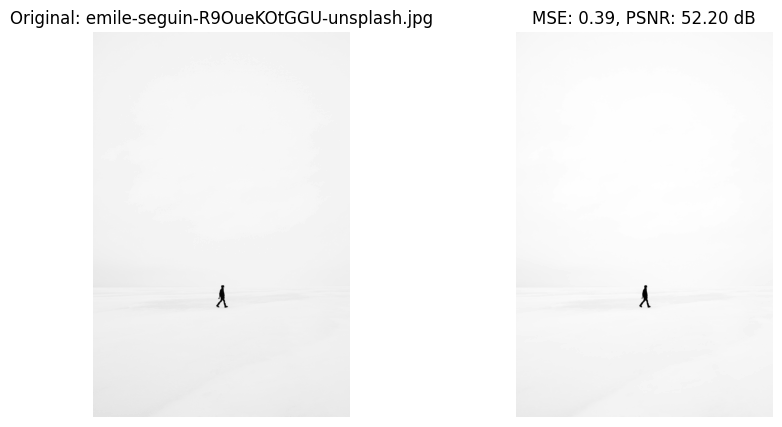

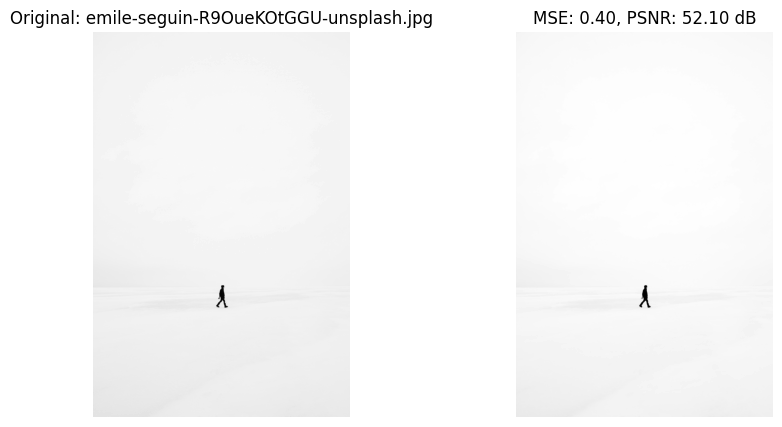

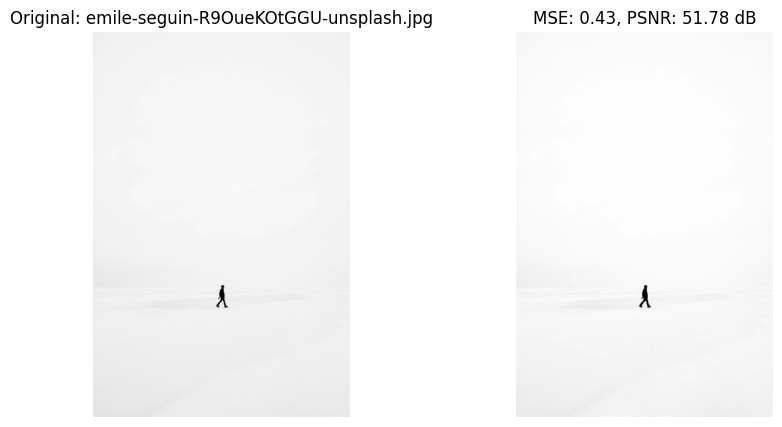

avarage mse = 35.424394962486105
avarage psnr = 36.776838008484354


In [54]:
counter = 0
mse_sum = 0
psnr_sum = 0

for index, row in original.iterrows():
    original_img = row['image']

    filtered_img_rows = filtered_images[filtered_images['filename'].str.contains(row['filename'])]

    for _, filtered_row in filtered_img_rows.iterrows():
        filtered_img = filtered_row['image']

        mse = calculate_mse(original_img, filtered_img)
        mse_sum += mse
        psnr = calculate_psnr(mse)
        psnr_sum += psnr

        counter +=1

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title(f"Original: {row['filename']}")
        axes[0].axis('off')

        axes[1].imshow(filtered_img, cmap='gray')
        axes[1].set_title(f"MSE: {mse:.2f}, PSNR: {psnr:.2f} dB")
        axes[1].axis('off')

        plt.show()

avrg_mse = mse_sum/counter
average_MSE["Salt and Pepper"].append(avrg_mse)
print(f"avarage mse = {avrg_mse}")

avrg_psnr = psnr_sum/counter
average_psnr["Salt and Pepper"].append(avrg_psnr)
print(f"avarage psnr = {avrg_psnr}")

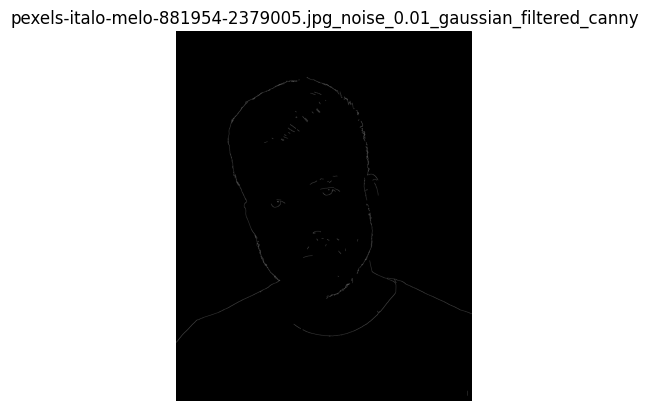

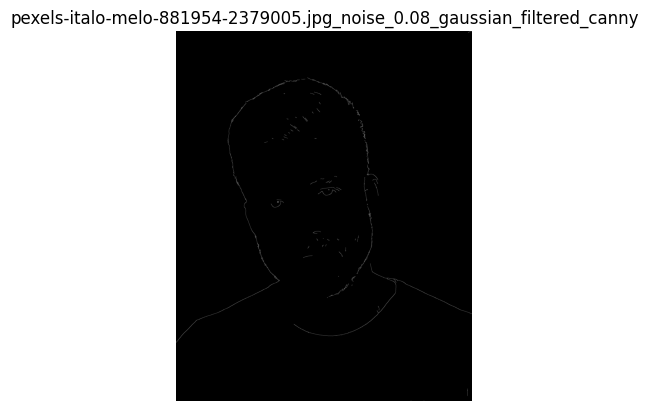

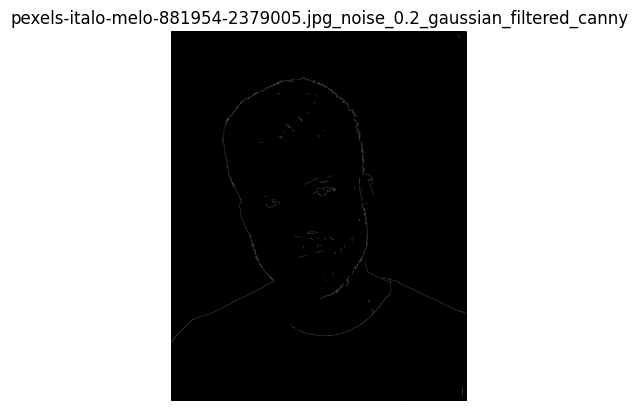

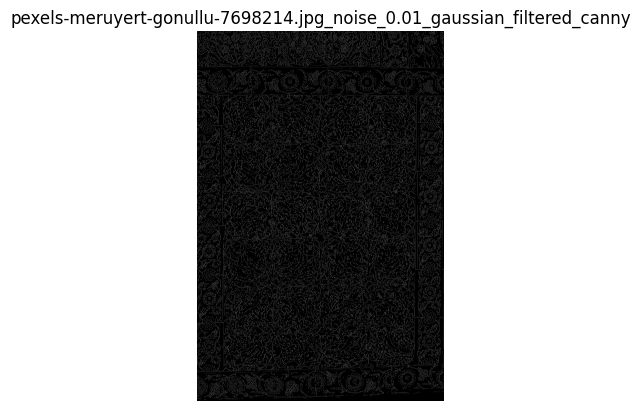

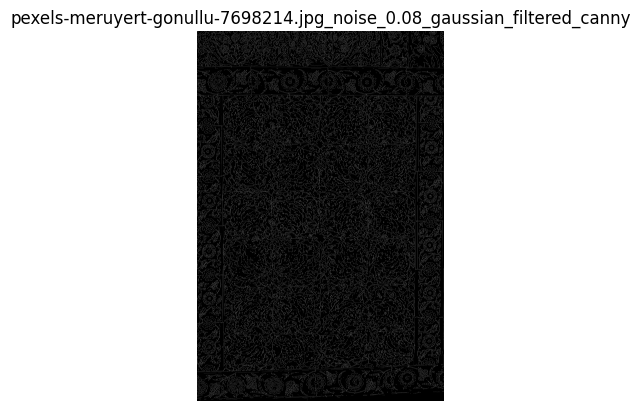

...

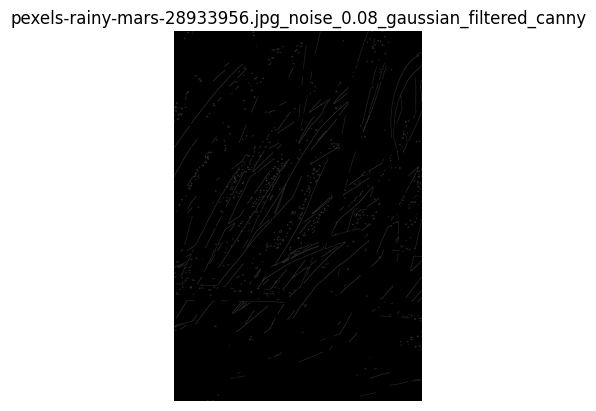

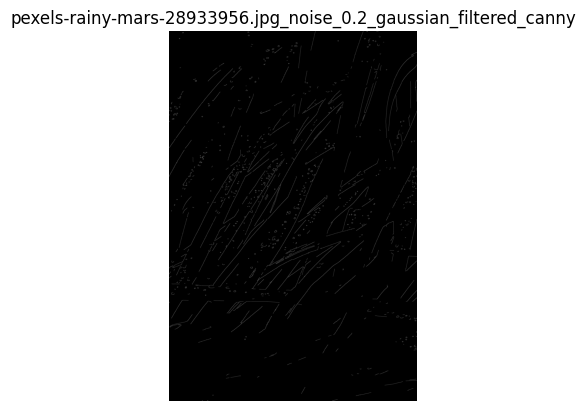

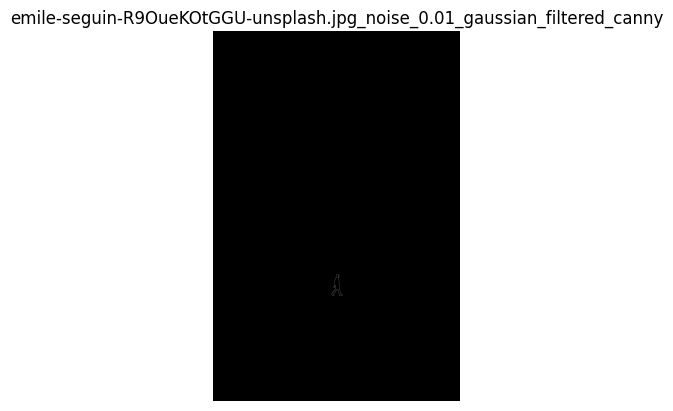

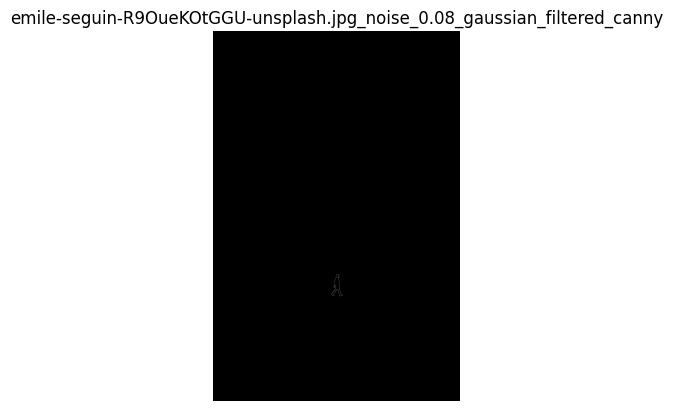

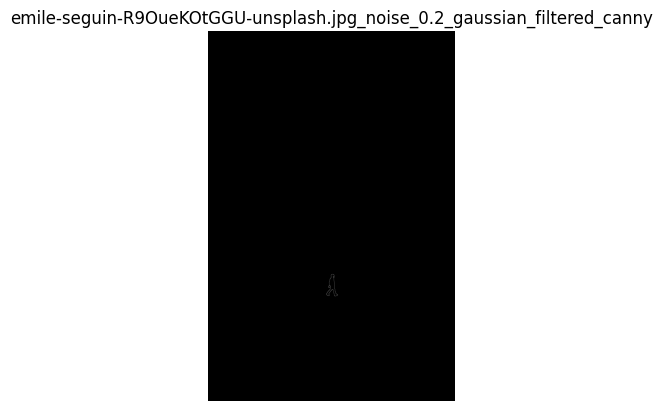

In [14]:
canny_data = []

for index, row in filtered_images.iterrows():
    canny_edges = apply_canny_edge(row['image'], threshold1=100, threshold2=200)
    canny_data.append({
        'filename': f"{row['filename']}_canny",
        'image': canny_edges
    })

canny_edges_df = pd.DataFrame(canny_data)

for index, row in canny_edges_df.iterrows():
    plt.imshow(row['image'], cmap='gray')
    plt.title(row['filename'])
    plt.axis('off')
    plt.show()

While the images still are visually appealing, and very similar to the original ones, the average MSE suffered. Going from 26.64 to 35.42, also the edges detected by Canny became much thinner, with the originally thin edges going undetected.



That is because with a bigger kernel going through an edge, much more pixels belonging to the background/object are present rather than edges' pixels. Leading to the median having a higher chance of being the value of a background/object pixel.



Going through an edge with a big kernel will get rid of most of its pixels leaving only the peak value, if the edge was originally thick enough.

Leading to higher values of MSE and thinner detected edges.

# Gaussian Nose:

In [15]:
def add_gaussian_noise(image, var, mean=20):
    sigma = var**0.5
    gaussian_noise = np.random.normal(mean, sigma, image.shape)

    noisy_image = image + gaussian_noise

    noisy_image = np.clip(noisy_image, 0, 255).astype(np.uint8)

    return noisy_image

gaussian_variances = [500, 1000, 2000]

noisy_data_gaussian = []

for index, row in original.iterrows():
    for var in gaussian_variances:
        noisy_img = add_gaussian_noise(row['image'], var=var)
        noisy_data_gaussian.append({
            'filename': f"{row['filename']}_gaussian_{var}",
            'image': noisy_img,
            'variance': var
        })

gaussian_noise = pd.DataFrame(noisy_data_gaussian)


In [55]:
Computational_times["Gaussian"] = []
average_MSE["Gaussian"] = []
average_psnr["Gaussian"] = []

In [56]:
start_time = time.time()

filtered_data = []

for index, row in gaussian_noise.iterrows():
    filtered_img = apply_median_filter(row['image'], ksize=5)
    filtered_data.append({
        'filename': f"{row['filename']}_gaussian_filtered",
        'image': filtered_img,
    })

end_time = time.time()

total_time = end_time - start_time
Computational_times["Gaussian"].append(total_time)
print(f"Total computational time for applying Median filter: {total_time:.4f} seconds")

filtered_images = pd.DataFrame(filtered_data)

Total computational time for applying Median filter: 0.4856 seconds


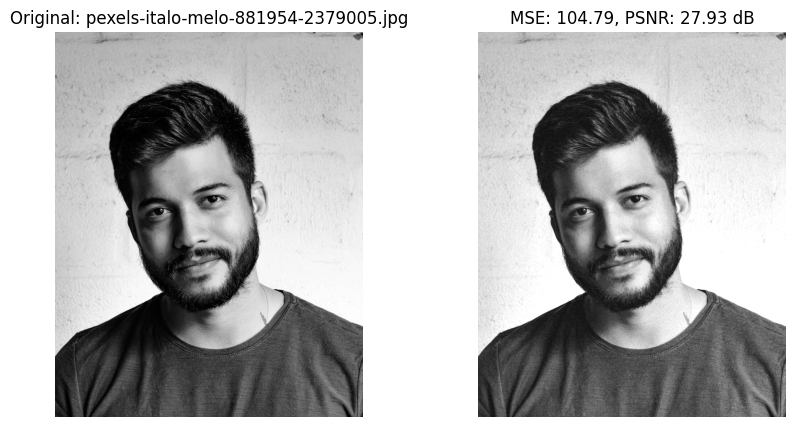

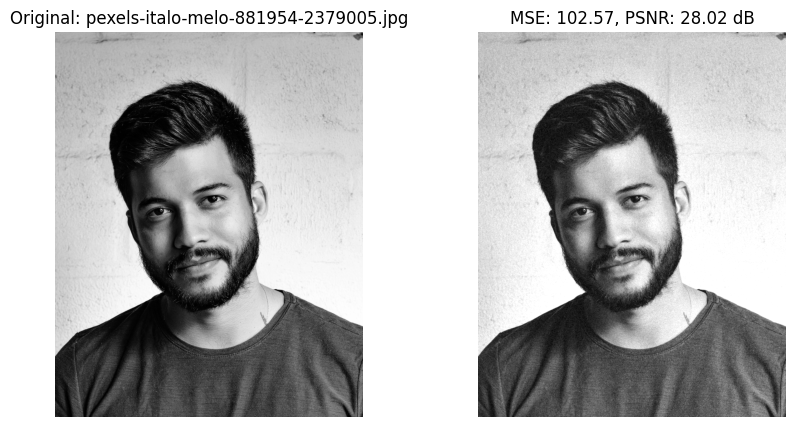

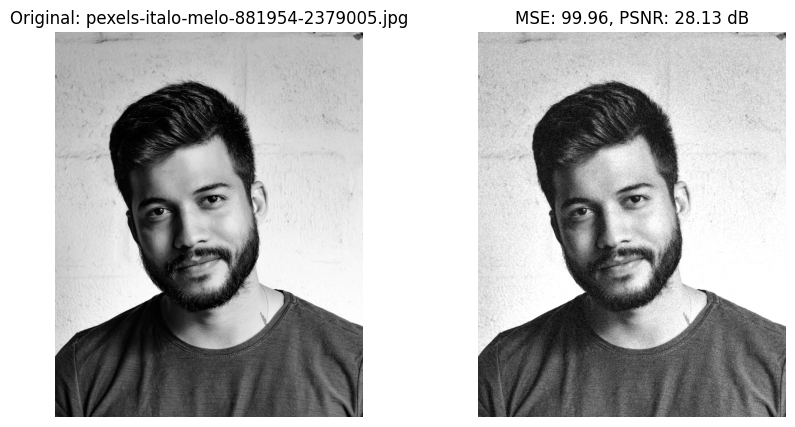

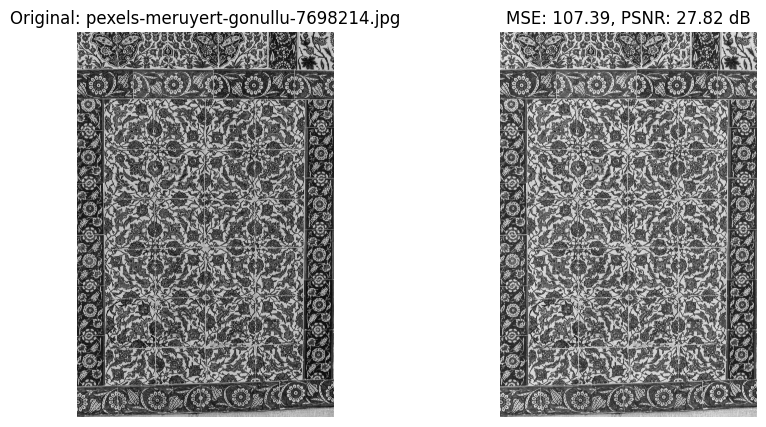

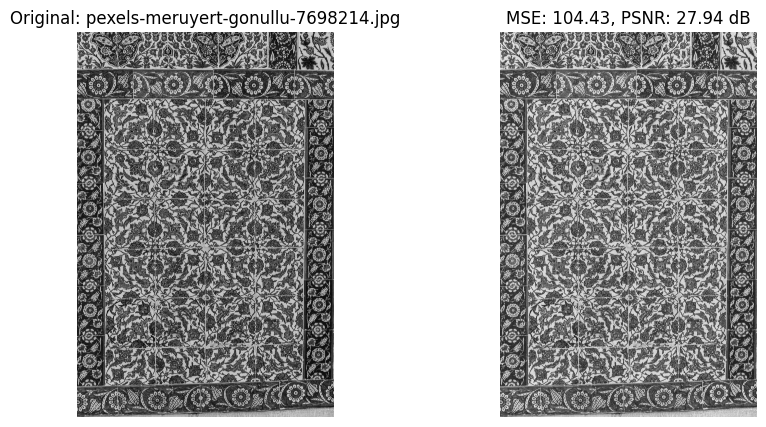

...

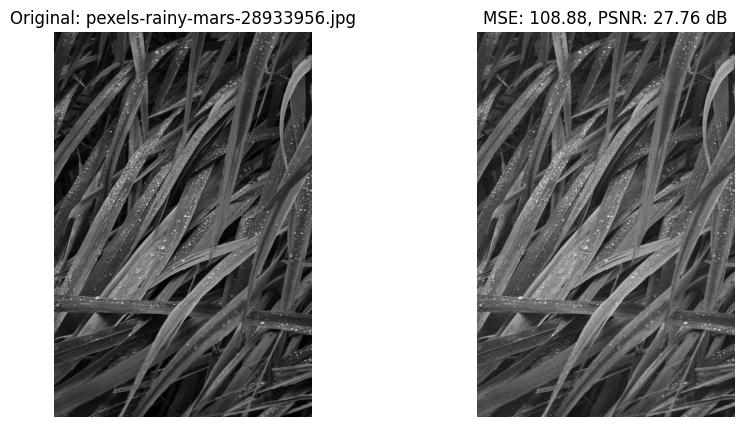

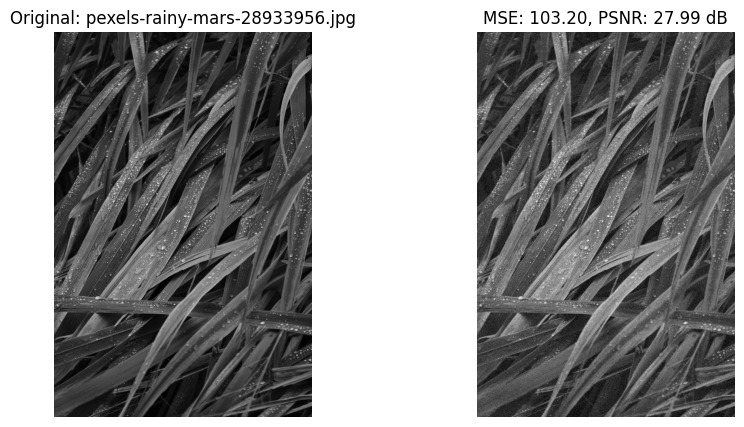

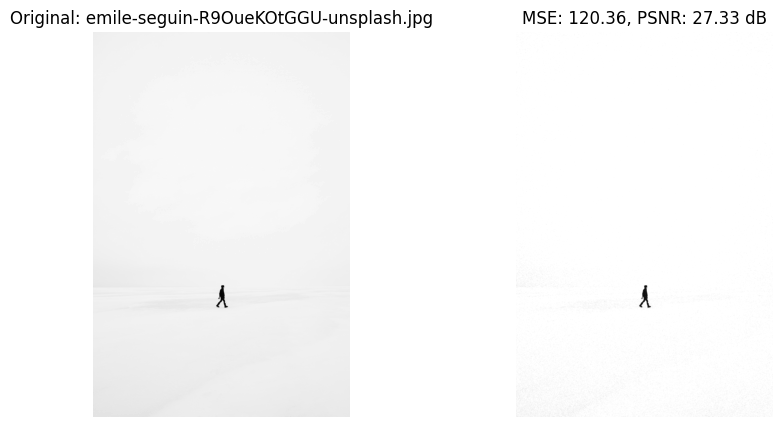

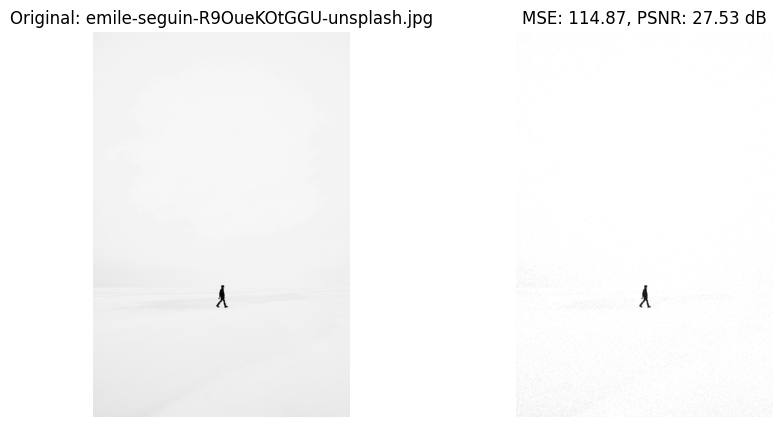

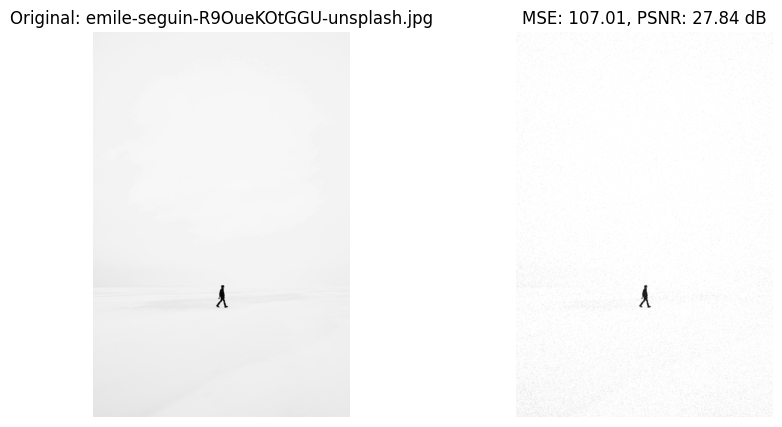

avarage mse = 107.36823972710988
avarage psnr = 27.828342800286617


In [57]:
counter = 0
mse_sum = 0
psnr_sum = 0

for index, row in original.iterrows():
    original_img = row['image']

    filtered_img_rows = filtered_images[filtered_images['filename'].str.contains(row['filename'])]

    for _, filtered_row in filtered_img_rows.iterrows():
        filtered_img = filtered_row['image']

        mse = calculate_mse(original_img, filtered_img)
        mse_sum += mse
        psnr = calculate_psnr(mse)
        psnr_sum += psnr

        counter +=1

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title(f"Original: {row['filename']}")
        axes[0].axis('off')

        axes[1].imshow(filtered_img, cmap='gray')
        axes[1].set_title(f"MSE: {mse:.2f}, PSNR: {psnr:.2f} dB")
        axes[1].axis('off')

        plt.show()

avrg_mse = mse_sum/counter
average_MSE["Gaussian"].append(avrg_mse)
print(f"avarage mse = {avrg_mse}")

avrg_psnr = psnr_sum/counter
average_psnr["Gaussian"].append(avrg_psnr)
print(f"avarage psnr = {avrg_psnr}")

Median filter didn't do as good on Gaussian noise, the output got a much higher average MSE equal to 107.36, as Gaussian noise isn't the presence of outliers, but noisy values gradually different from their original values.

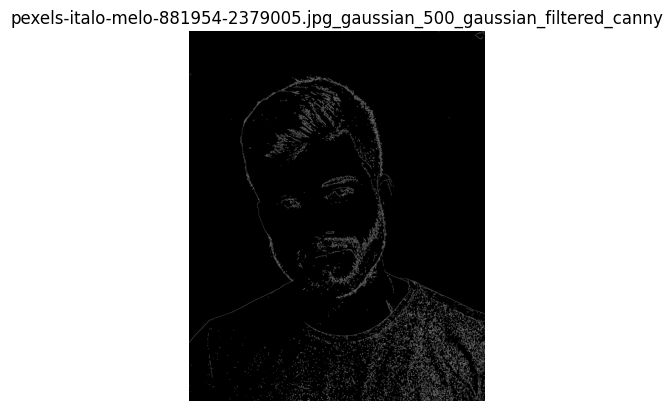

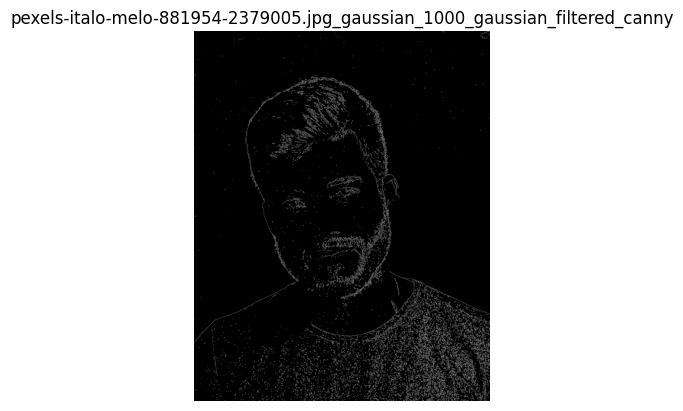

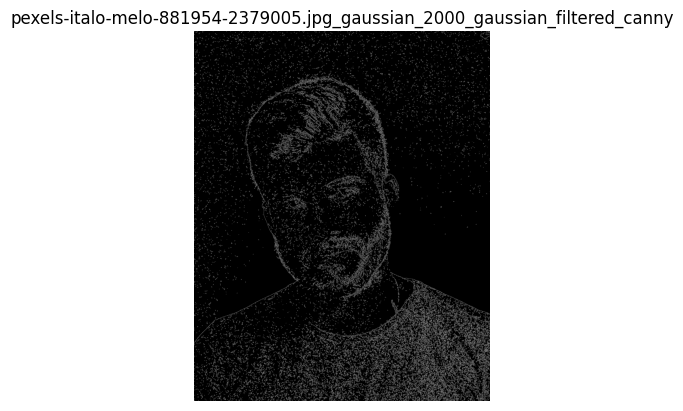

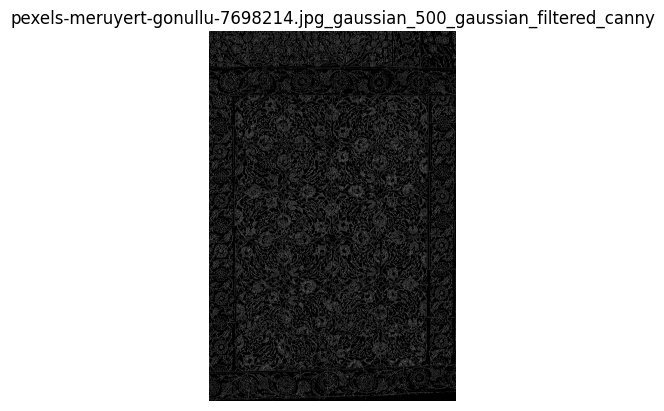

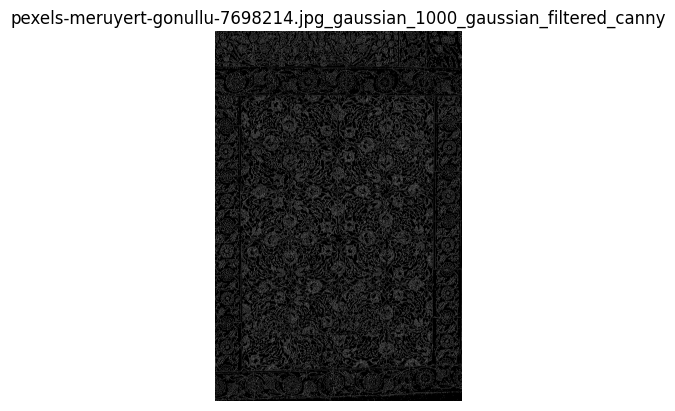

...

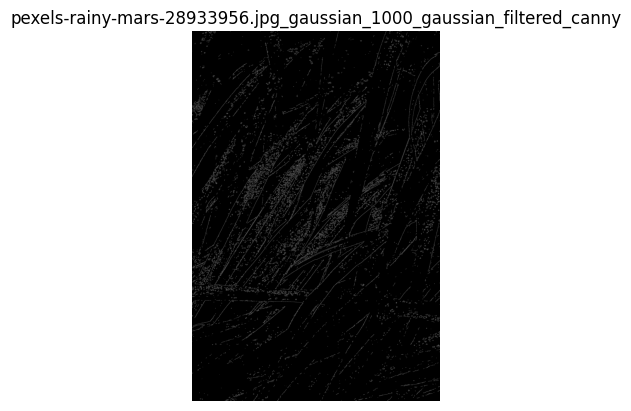

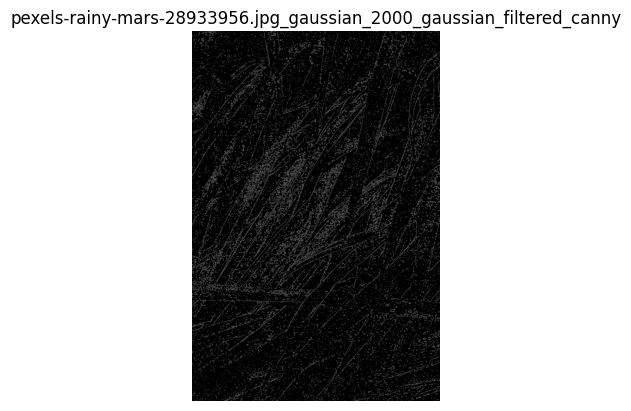

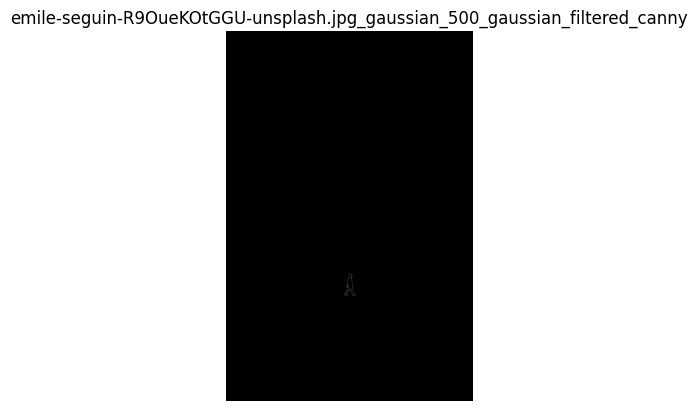

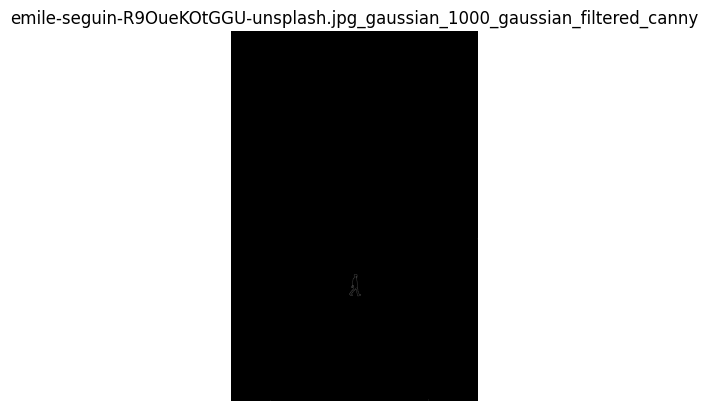

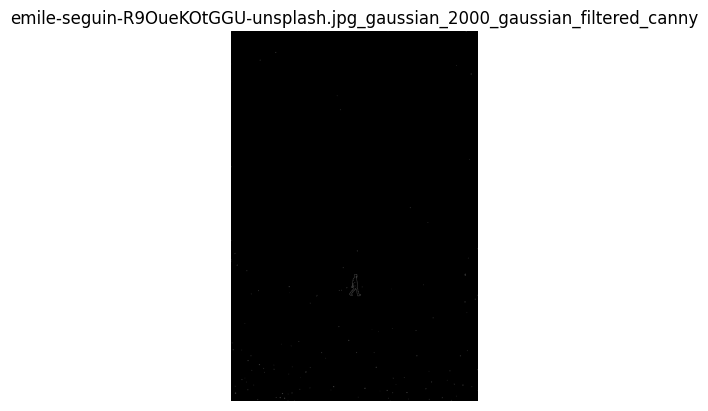

In [25]:
canny_data = []

for index, row in filtered_images.iterrows():
    canny_edges = apply_canny_edge(row['image'], threshold1=100, threshold2=200)
    canny_data.append({
        'filename': f"{row['filename']}_canny",
        'image': canny_edges
    })

canny_edges_df = pd.DataFrame(canny_data)

for index, row in canny_edges_df.iterrows():
    plt.imshow(row['image'], cmap='gray')
    plt.title(row['filename'])
    plt.axis('off')
    plt.show()

Detecting the edges didn't suffer much.

In [58]:
start_time = time.time()

filtered_data = []

for index, row in gaussian_noise.iterrows():
    filtered_img = apply_median_filter(row['image'], ksize=11)
    filtered_data.append({
        'filename': f"{row['filename']}_gaussian_filtered",
        'image': filtered_img,
    })

end_time = time.time()

total_time = end_time - start_time
Computational_times["Gaussian"].append(total_time)
print(f"Total computational time for applying Median filter: {total_time:.4f} seconds")

filtered_images = pd.DataFrame(filtered_data)

Total computational time for applying Median filter: 8.1267 seconds


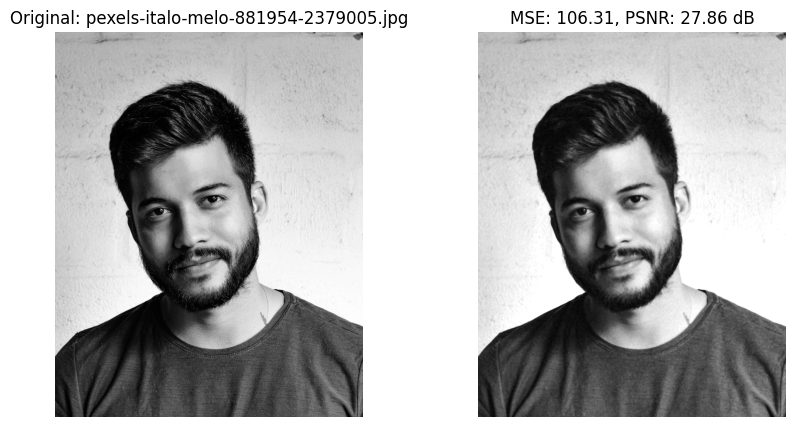

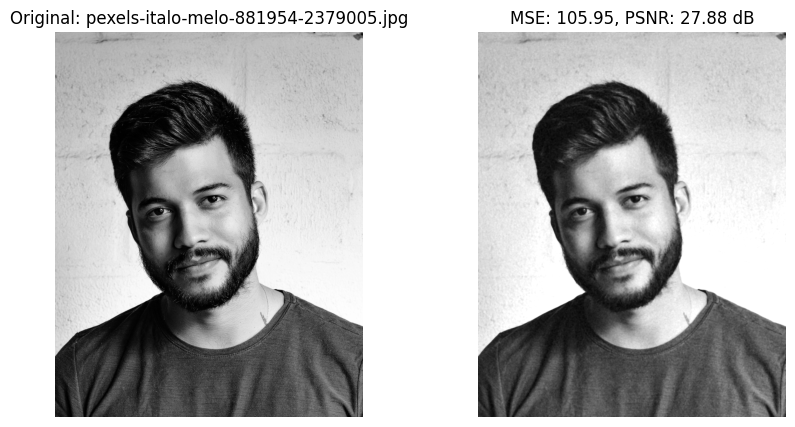

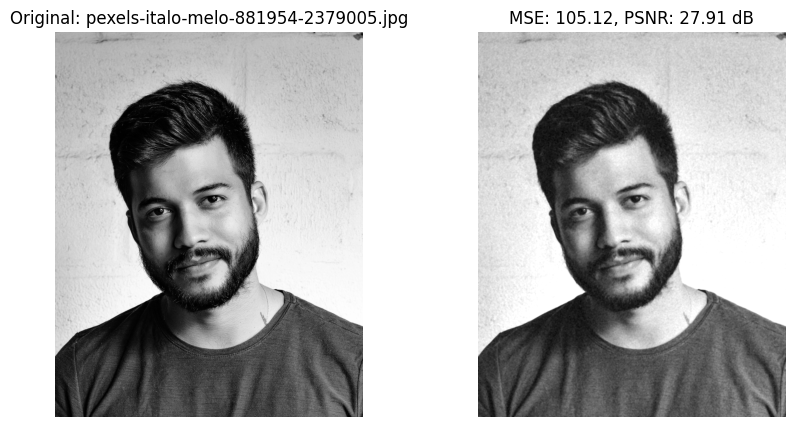

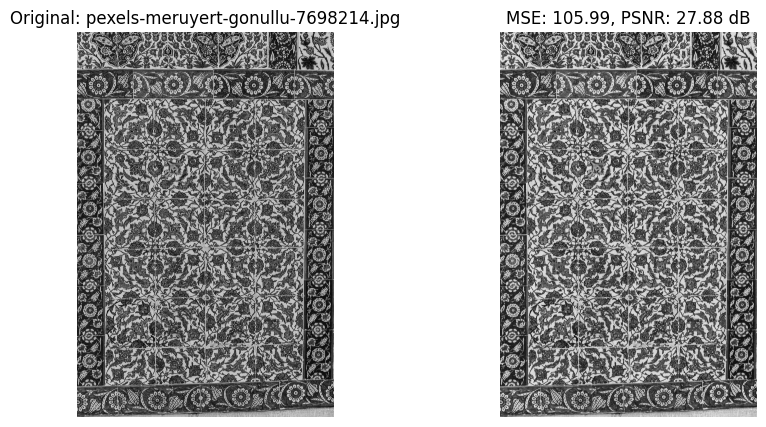

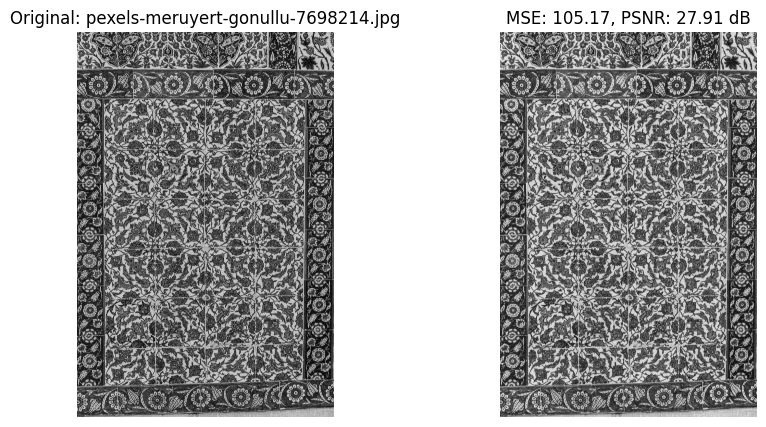

...

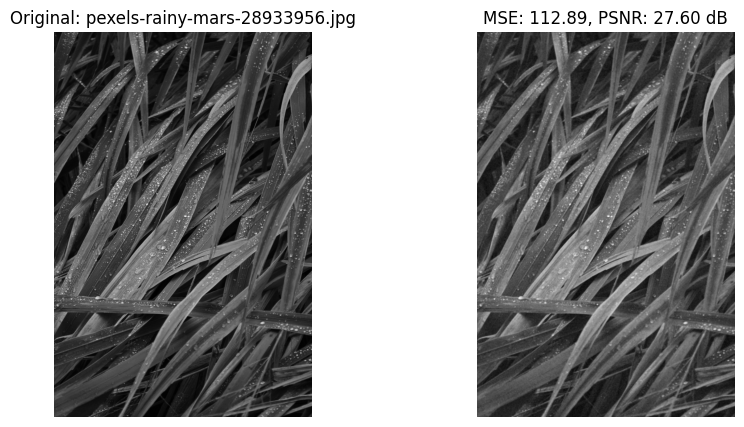

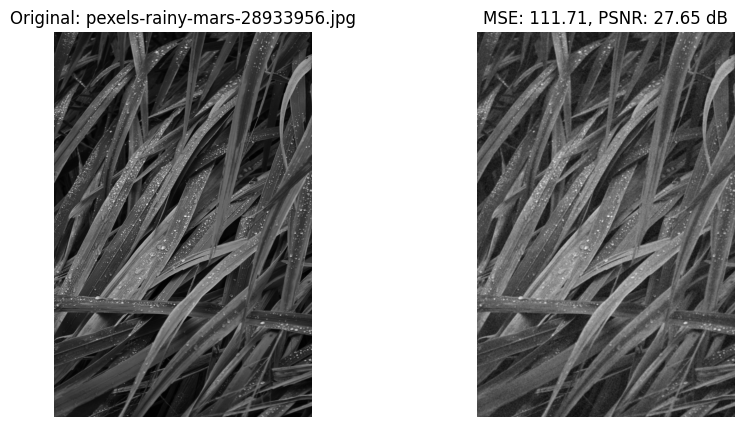

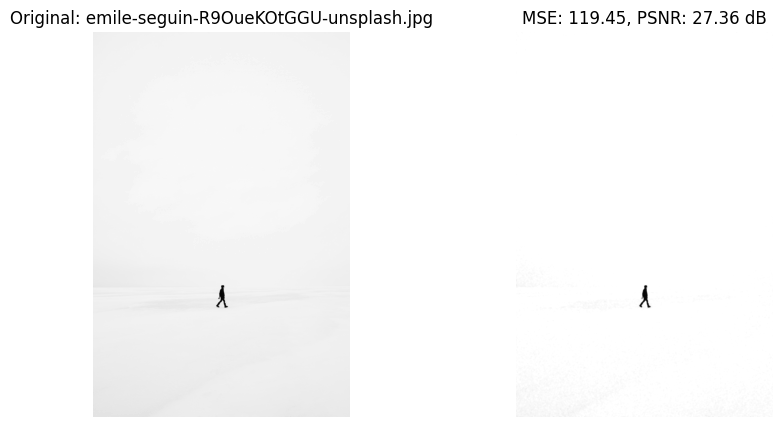

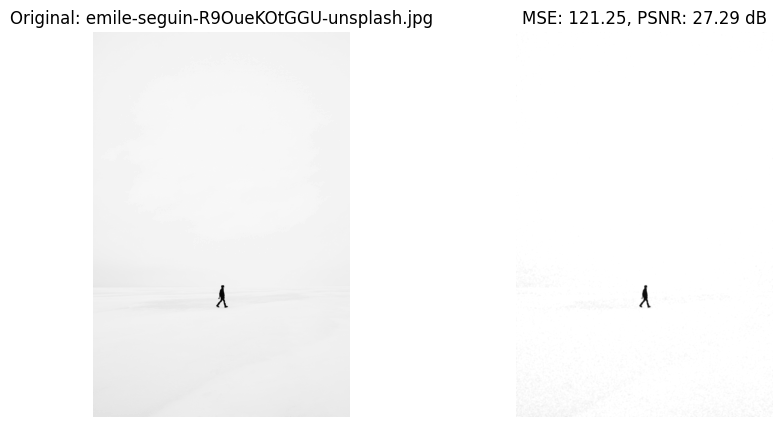

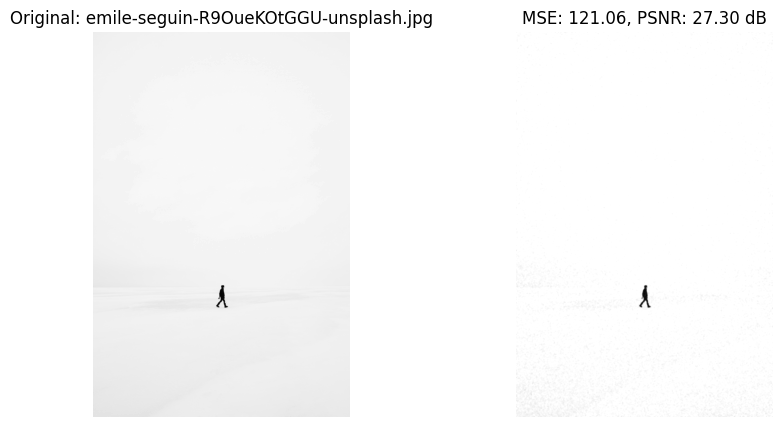

avarage mse = 111.03495489741941
avarage psnr = 27.682999285008776


In [59]:
counter = 0
mse_sum = 0
psnr_sum = 0

for index, row in original.iterrows():
    original_img = row['image']

    filtered_img_rows = filtered_images[filtered_images['filename'].str.contains(row['filename'])]

    for _, filtered_row in filtered_img_rows.iterrows():
        filtered_img = filtered_row['image']

        mse = calculate_mse(original_img, filtered_img)
        mse_sum += mse
        psnr = calculate_psnr(mse)
        psnr_sum += psnr

        counter +=1

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title(f"Original: {row['filename']}")
        axes[0].axis('off')

        axes[1].imshow(filtered_img, cmap='gray')
        axes[1].set_title(f"MSE: {mse:.2f}, PSNR: {psnr:.2f} dB")
        axes[1].axis('off')

        plt.show()

avrg_mse = mse_sum/counter
average_MSE["Gaussian"].append(avrg_mse)
print(f"avarage mse = {avrg_mse}")

avrg_psnr = psnr_sum/counter
average_psnr["Gaussian"].append(avrg_psnr)
print(f"avarage psnr = {avrg_psnr}")

It could be noticed that in low detail images that some details were removed and replaced with the majority of the background, such is how the Median filter works.

Although the kernel size doubled the average MSE and PSNR didn't change much.

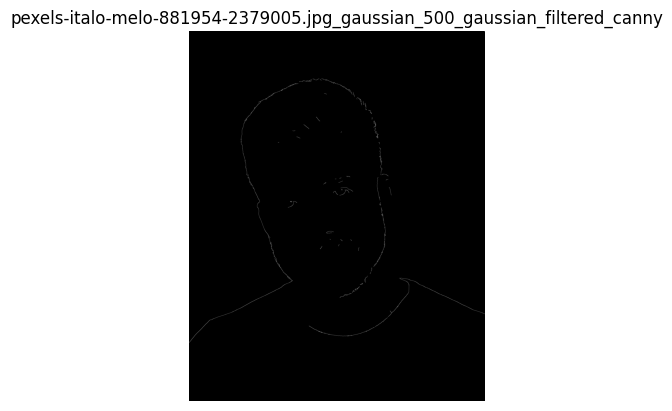

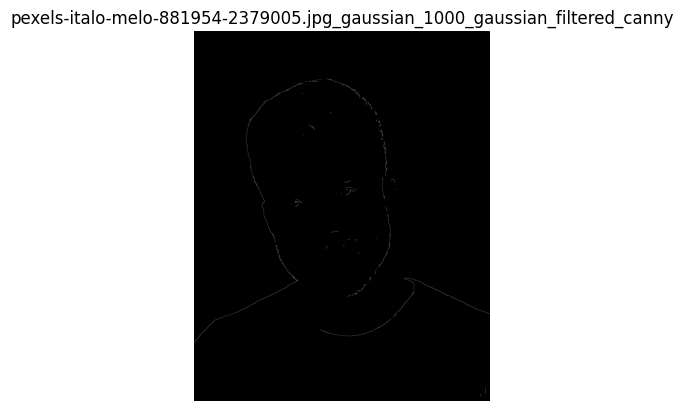

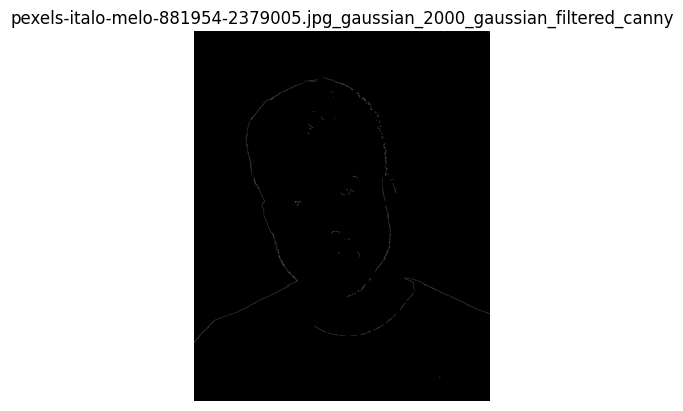

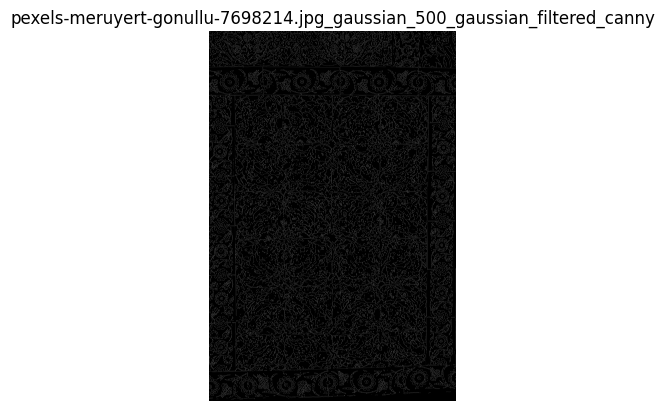

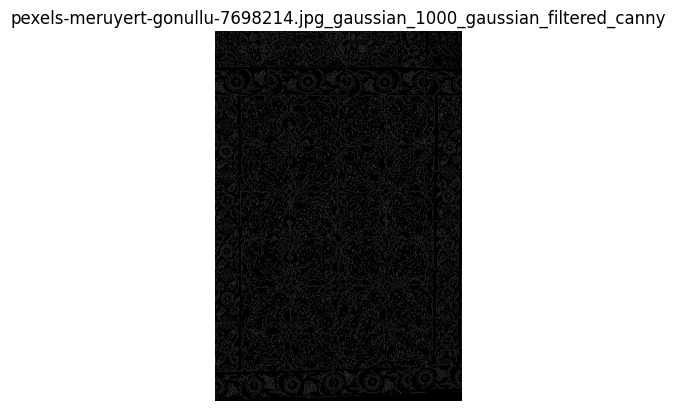

...

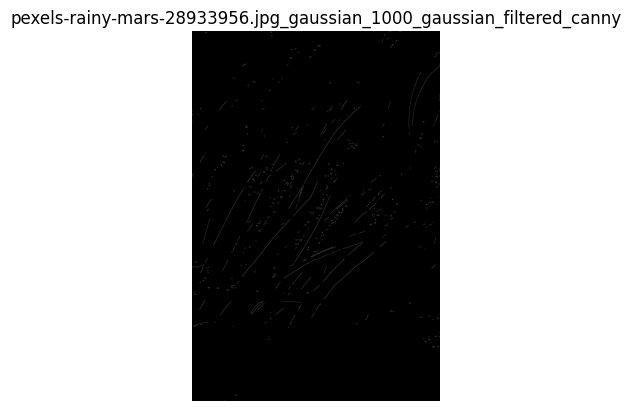

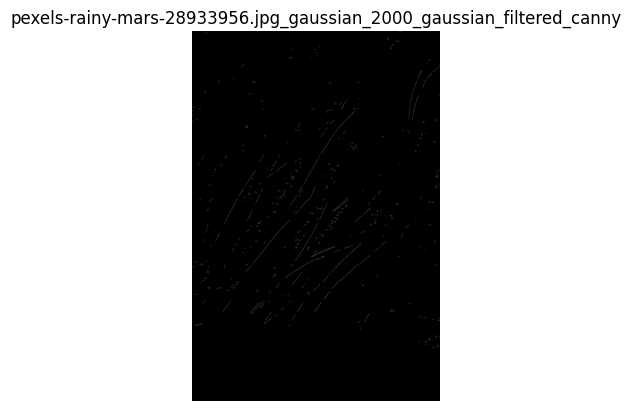

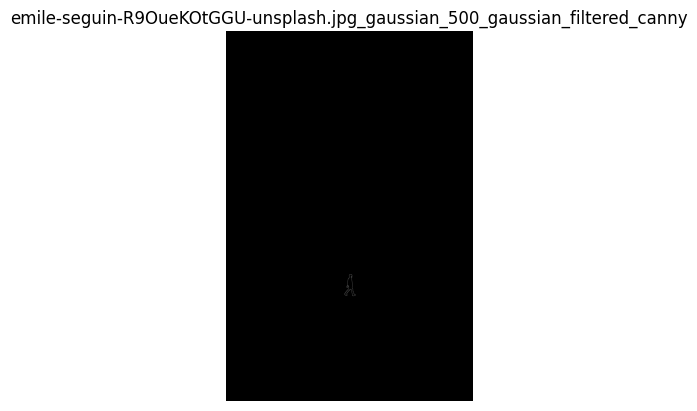

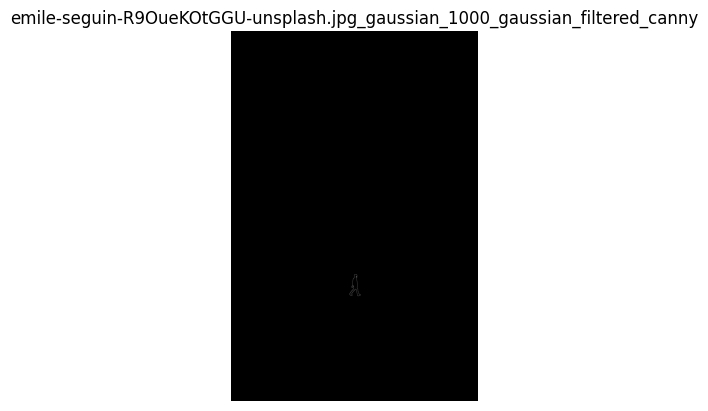

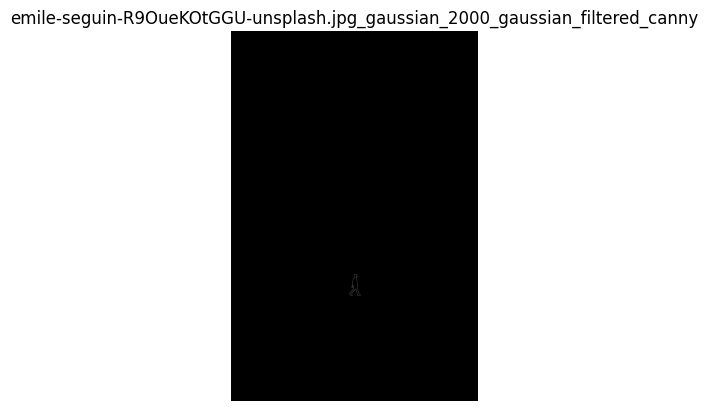

In [28]:
canny_data = []

for index, row in filtered_images.iterrows():
    canny_edges = apply_canny_edge(row['image'], threshold1=100, threshold2=200)
    canny_data.append({
        'filename': f"{row['filename']}_canny",
        'image': canny_edges
    })

canny_edges_df = pd.DataFrame(canny_data)

for index, row in canny_edges_df.iterrows():
    plt.imshow(row['image'], cmap='gray')
    plt.title(row['filename'])
    plt.axis('off')
    plt.show()

Same as with salt and pepper noise, with bigger kernel less edges were detected, and the detected edges became much thinner.

# Poisson Noise:

In [29]:
def add_poisson_noise(image):
    noisy_image = np.random.poisson(image).astype(np.uint8)
    noisy_image = np.clip(noisy_image, 0, 255)
    return noisy_image

noisy_data_poisson = []

for index, row in original.iterrows():
    noisy_img = add_poisson_noise(row['image'])
    noisy_data_poisson.append({
        'filename': f"{row['filename']}_poisson",
        'image': noisy_img,
        'noise_type': 'poisson'
    })

noisy_poisson = pd.DataFrame(noisy_data_poisson)

In [60]:
Computational_times["Poisson"] = []
average_MSE["Poisson"] = []
average_psnr["Poisson"] = []

In [61]:
start_time = time.time()

filtered_data = []

for index, row in noisy_poisson.iterrows():
    filtered_img = apply_median_filter(row['image'], ksize=5)
    filtered_data.append({
        'filename': f"{row['filename']}_gaussian_filtered",
        'image': filtered_img,
    })

end_time = time.time()

total_time = end_time - start_time
Computational_times["Poisson"].append(total_time)
print(f"Total computational time for applying Median filter: {total_time:.4f} seconds")

filtered_images = pd.DataFrame(filtered_data)

Total computational time for applying Median filter: 0.1647 seconds


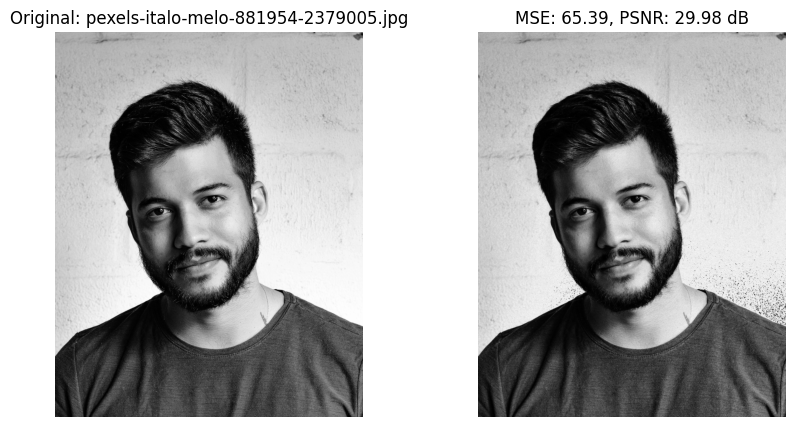

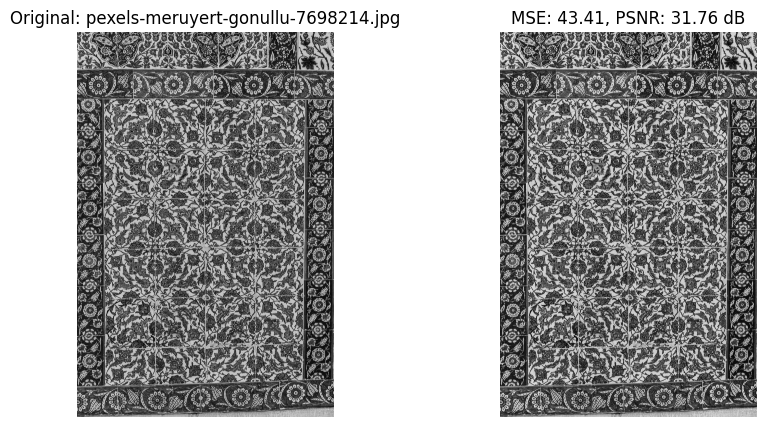

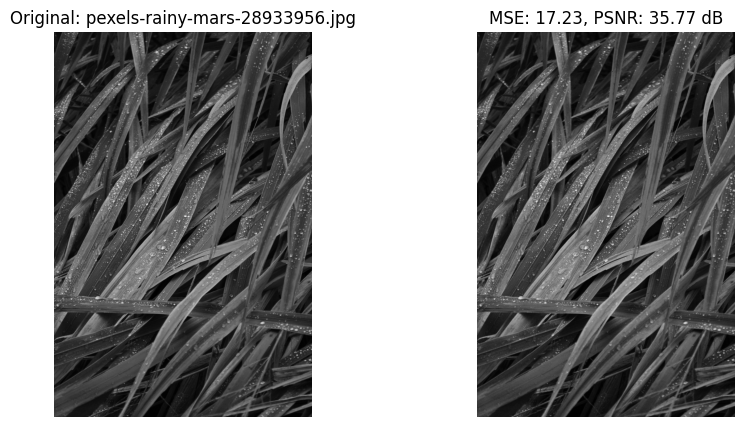

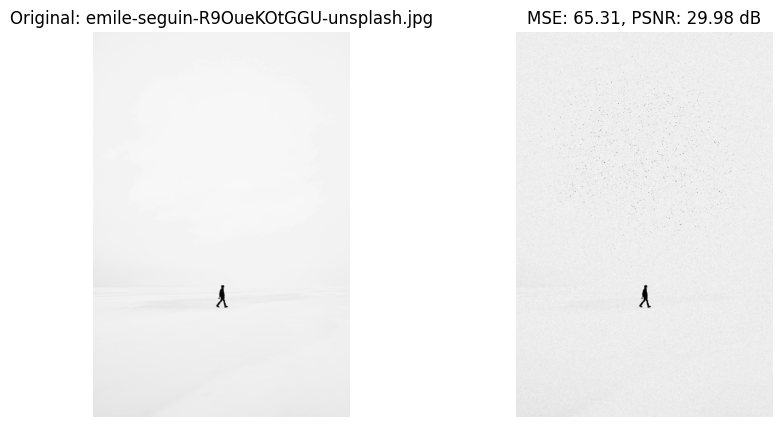

avarage mse = 47.833501878435456
avarage psnr = 31.87018597136634


In [62]:
counter = 0
mse_sum = 0
psnr_sum = 0

for index, row in original.iterrows():
    original_img = row['image']

    filtered_img_rows = filtered_images[filtered_images['filename'].str.contains(row['filename'])]

    for _, filtered_row in filtered_img_rows.iterrows():
        filtered_img = filtered_row['image']

        mse = calculate_mse(original_img, filtered_img)
        mse_sum += mse
        psnr = calculate_psnr(mse)
        psnr_sum += psnr

        counter +=1

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title(f"Original: {row['filename']}")
        axes[0].axis('off')

        axes[1].imshow(filtered_img, cmap='gray')
        axes[1].set_title(f"MSE: {mse:.2f}, PSNR: {psnr:.2f} dB")
        axes[1].axis('off')

        plt.show()

avrg_mse = mse_sum/counter
average_MSE["Poisson"].append(avrg_mse)
print(f"avarage mse = {avrg_mse}")

avrg_psnr = psnr_sum/counter
average_psnr["Poisson"].append(avrg_psnr)
print(f"avarage psnr = {avrg_psnr}")

Although the Poisson noise could be viewed as darkening of parts of the image, or outliers of low values, the Median filter didn't perform the same as with salt and pepper noise.


The average MSE is much higher than 26.64 as it was calculated to be equal to 47.83 (almost double). That is because in salt and pepper noise the high valued outliers 'canceled' the low valued outliers, keeping the median in the middle.


In Poisson noise the noisy outliers skew the median to be closer to -sometimes one of- the outliers. Hence why some of the images (especially low noise levels) are seen as if the noise were distributed throughout the image.

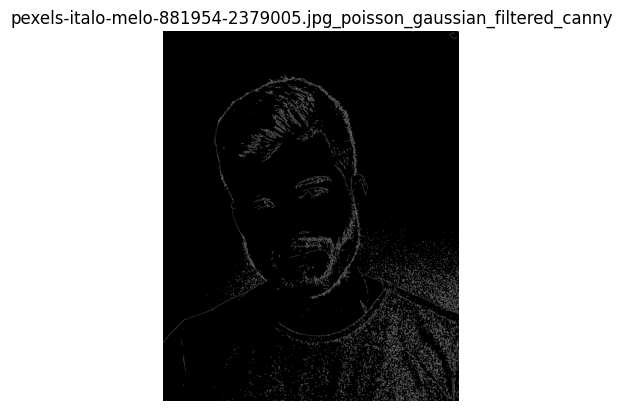

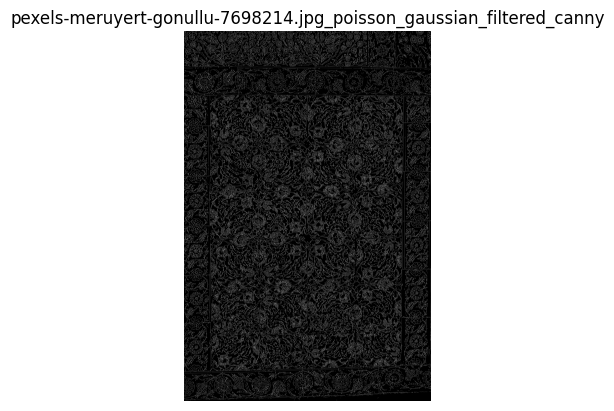

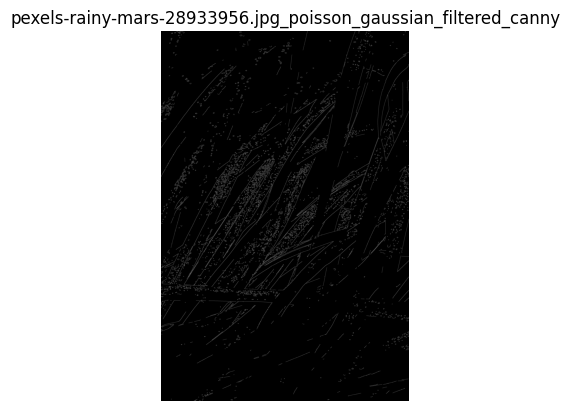

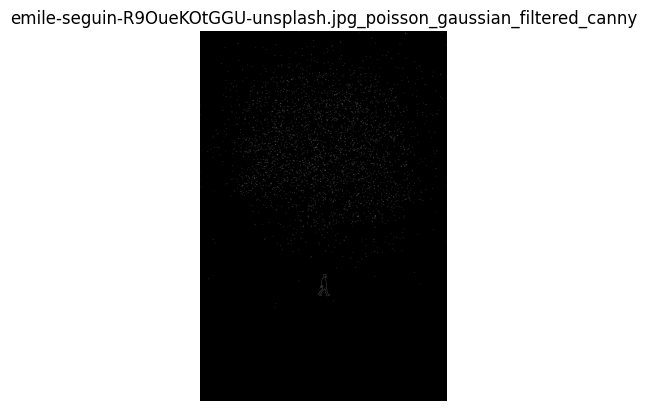

In [35]:
canny_data = []

for index, row in filtered_images.iterrows():
    canny_edges = apply_canny_edge(row['image'], threshold1=100, threshold2=200)
    canny_data.append({
        'filename': f"{row['filename']}_canny",
        'image': canny_edges
    })

canny_edges_df = pd.DataFrame(canny_data)

for index, row in canny_edges_df.iterrows():
    plt.imshow(row['image'], cmap='gray')
    plt.title(row['filename'])
    plt.axis('off')
    plt.show()

Some of the noise was still detected as images.

In [63]:
start_time = time.time()

filtered_data = []

for index, row in noisy_poisson.iterrows():
    filtered_img = apply_median_filter(row['image'], ksize=11)
    filtered_data.append({
        'filename': f"{row['filename']}_gaussian_filtered",
        'image': filtered_img,
    })

end_time = time.time()

total_time = end_time - start_time
Computational_times["Poisson"].append(total_time)
print(f"Total computational time for applying Median filter: {total_time:.4f} seconds")

filtered_images = pd.DataFrame(filtered_data)

Total computational time for applying Median filter: 2.2314 seconds


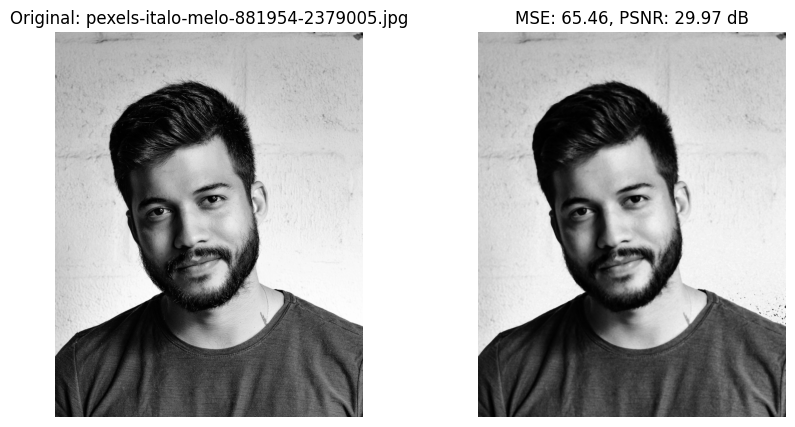

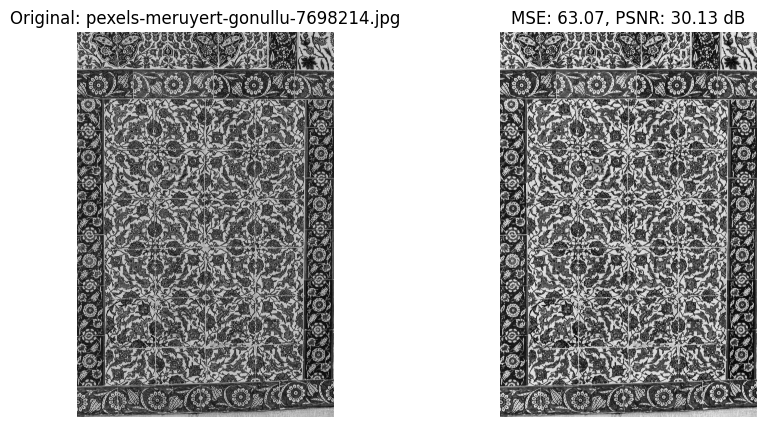

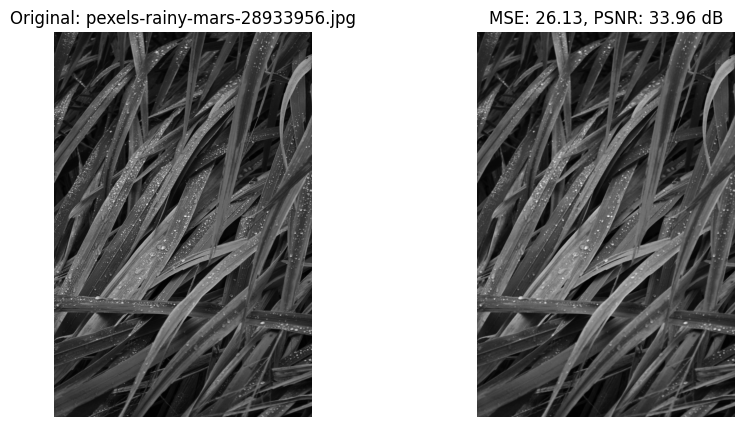

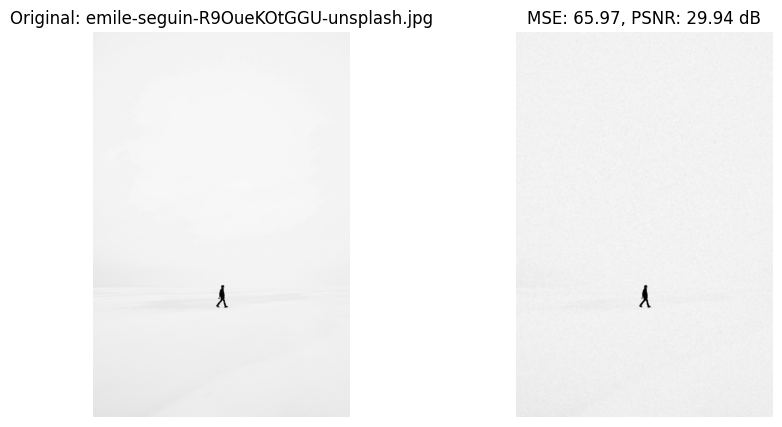

avarage mse = 55.157664127618844
avarage psnr = 31.00000959066424


In [64]:
counter = 0
mse_sum = 0
psnr_sum = 0

for index, row in original.iterrows():
    original_img = row['image']

    filtered_img_rows = filtered_images[filtered_images['filename'].str.contains(row['filename'])]

    for _, filtered_row in filtered_img_rows.iterrows():
        filtered_img = filtered_row['image']

        mse = calculate_mse(original_img, filtered_img)
        mse_sum += mse
        psnr = calculate_psnr(mse)
        psnr_sum += psnr

        counter +=1

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title(f"Original: {row['filename']}")
        axes[0].axis('off')

        axes[1].imshow(filtered_img, cmap='gray')
        axes[1].set_title(f"MSE: {mse:.2f}, PSNR: {psnr:.2f} dB")
        axes[1].axis('off')

        plt.show()

avrg_mse = mse_sum/counter
average_MSE["Poisson"].append(avrg_mse)
print(f"avarage mse = {avrg_mse}")

avrg_psnr = psnr_sum/counter
average_psnr["Poisson"].append(avrg_psnr)
print(f"avarage psnr = {avrg_psnr}")

The average MSE has got even bigger now. That's because the bigger kernel has a higher chance of containing more noisy pixels, and choosing an unsuitable median.

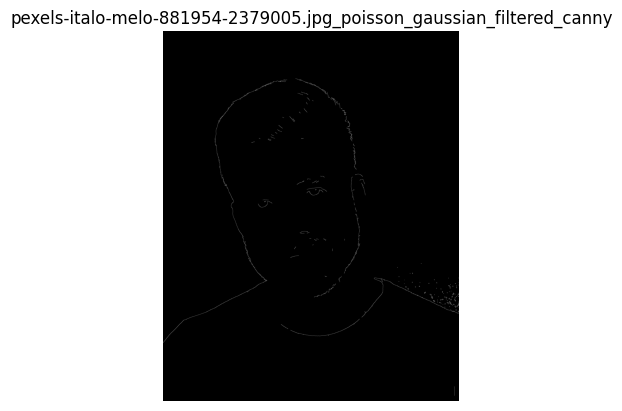

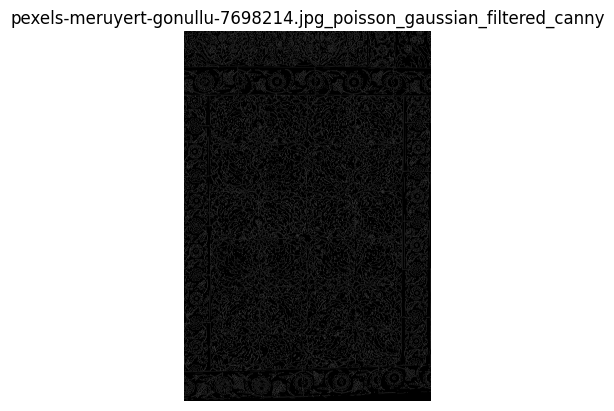

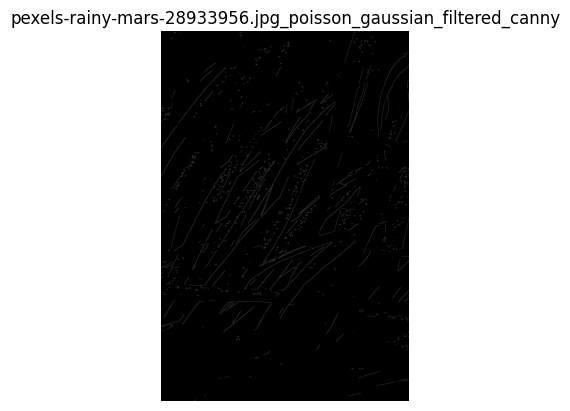

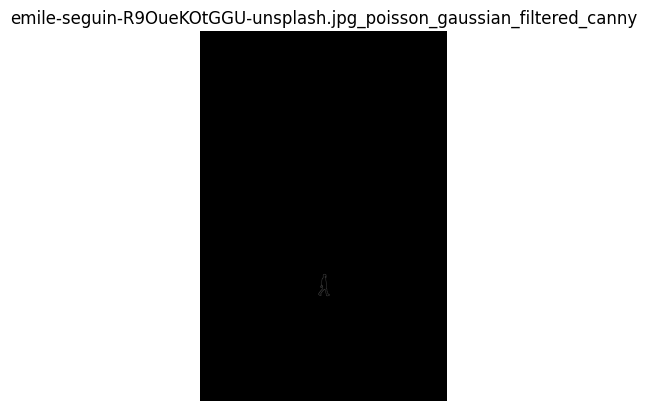

In [38]:
canny_data = []

for index, row in filtered_images.iterrows():
    canny_edges = apply_canny_edge(row['image'], threshold1=100, threshold2=200)
    canny_data.append({
        'filename': f"{row['filename']}_canny",
        'image': canny_edges
    })

canny_edges_df = pd.DataFrame(canny_data)

for index, row in canny_edges_df.iterrows():
    plt.imshow(row['image'], cmap='gray')
    plt.title(row['filename'])
    plt.axis('off')
    plt.show()

The case of detected edges becoming thinner, with originally thin edges going undetected with a bigger kernel still persisted.

# Speckle Noise:

In [39]:

def generate_speckle_noise(image_shape, mean=0, variance=0.01):
    noise = np.random.normal(mean, variance**0.5, size=image_shape)
    speckle_noise = noise * np.ones(image_shape)
    return speckle_noise

def add_speckle_noise(image, mean=0, variance=0.1):
    speckle_noise = generate_speckle_noise(image.shape, mean=mean, variance=variance)
    noisy_image = image + image * speckle_noise
    noisy_image = np.clip(noisy_image, 0, 255).astype(np.uint8)
    return noisy_image

speckle_variances = [0.05, 0.1, 0.2]

noisy_data_speckle = []

for index, row in original.iterrows():
    for var in speckle_variances:
        noisy_img = add_speckle_noise(row['image'], variance=var)
        noisy_data_speckle.append({
            'filename': f"{row['filename']}_speckle_{var}",
            'image': noisy_img,
            'variance': var
        })

speckle_noise = pd.DataFrame(noisy_data_speckle)

In [65]:
Computational_times["Speckle"] = []
average_MSE["Speckle"] = []
average_psnr["Speckle"] = []

In [66]:
start_time = time.time()

filtered_data = []

for index, row in speckle_noise.iterrows():
    filtered_img = apply_median_filter(row['image'], ksize=5)
    filtered_data.append({
        'filename': f"{row['filename']}_gaussian_filtered",
        'image': filtered_img,
    })

end_time = time.time()

total_time = end_time - start_time
Computational_times["Speckle"].append(total_time)
print(f"Total computational time for applying Median filter: {total_time:.4f} seconds")

filtered_images = pd.DataFrame(filtered_data)

Total computational time for applying Median filter: 0.5118 seconds


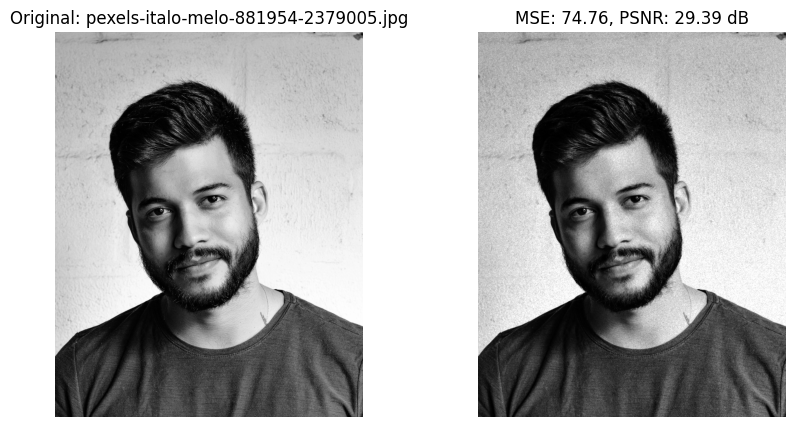

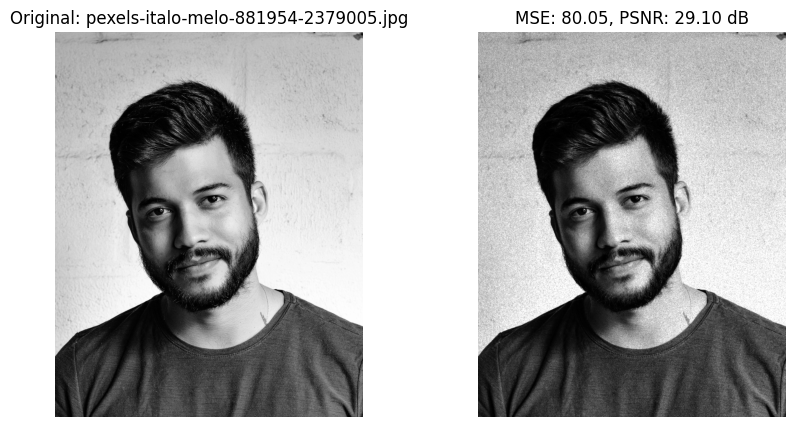

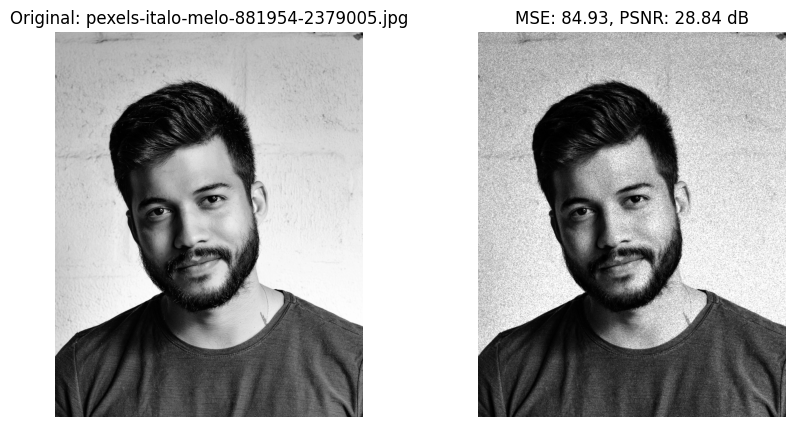

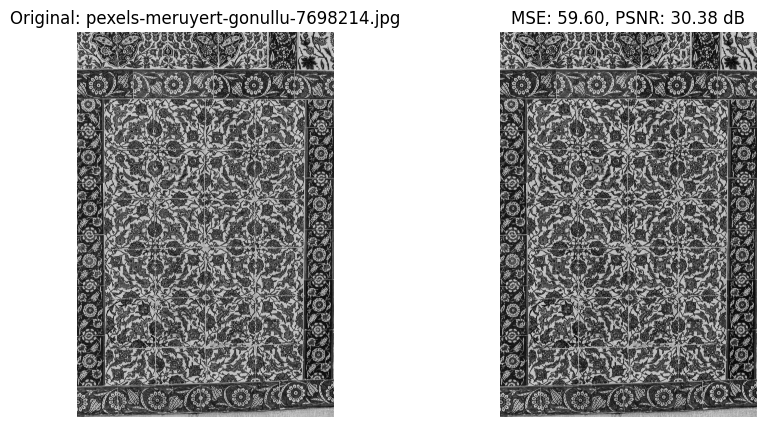

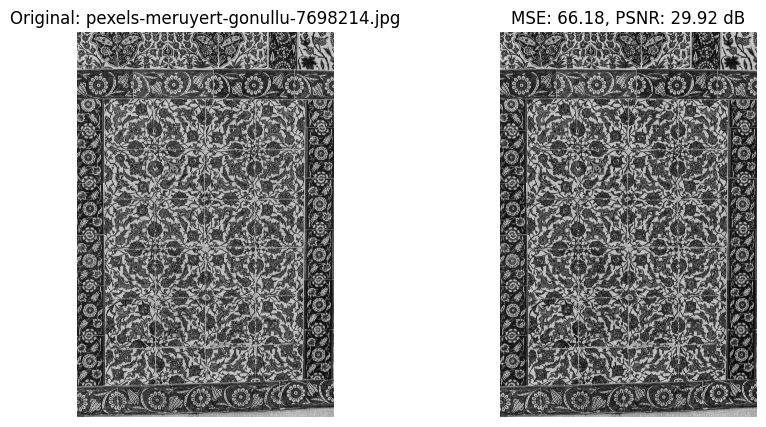

...

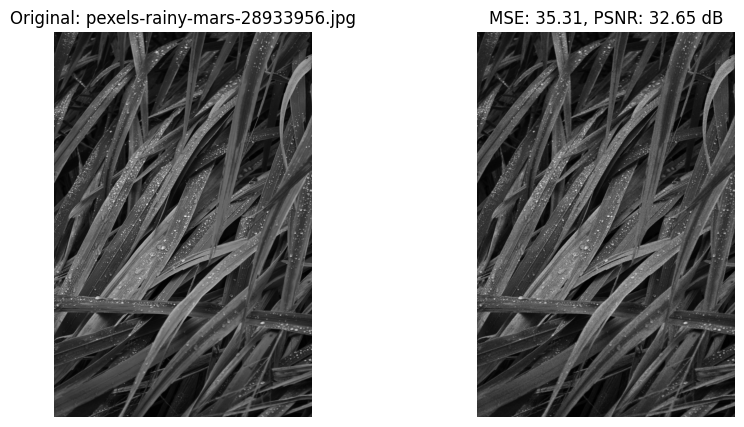

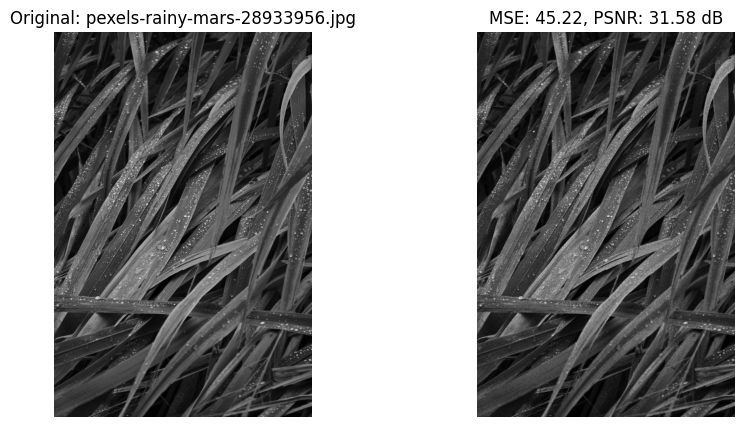

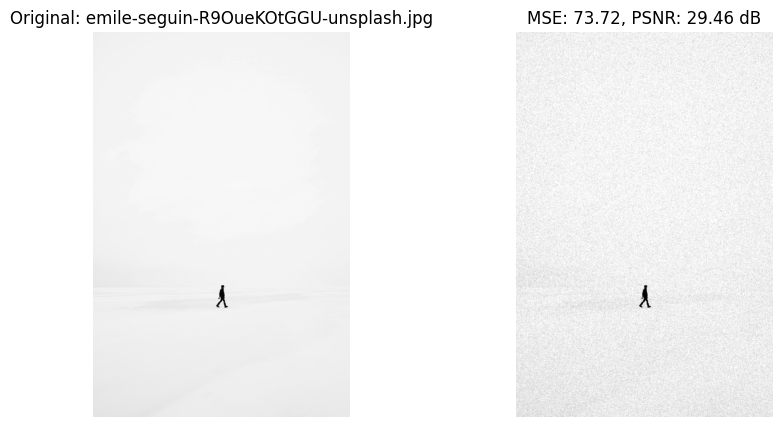

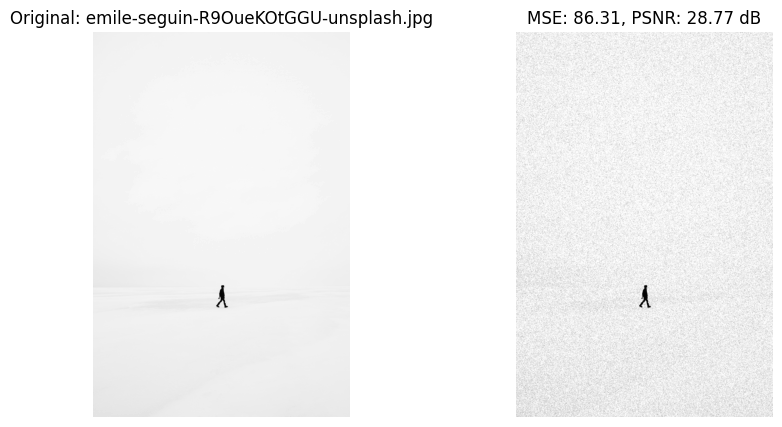

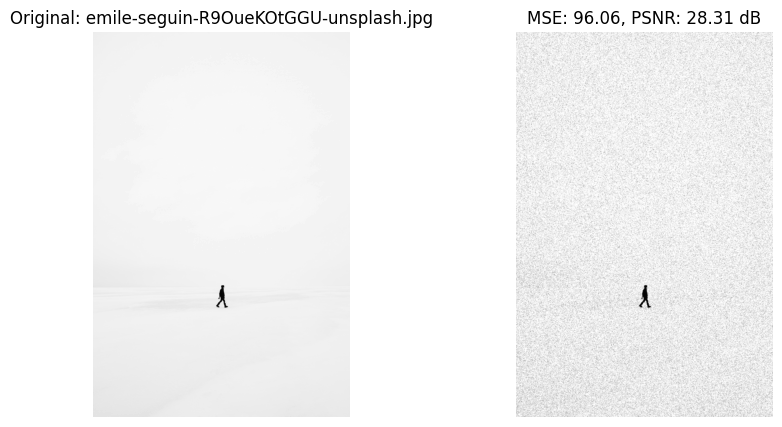

avarage mse = 66.83853438832894
avarage psnr = 30.140641957371162


In [67]:
counter = 0
mse_sum = 0
psnr_sum = 0

for index, row in original.iterrows():
    original_img = row['image']

    filtered_img_rows = filtered_images[filtered_images['filename'].str.contains(row['filename'])]

    for _, filtered_row in filtered_img_rows.iterrows():
        filtered_img = filtered_row['image']

        mse = calculate_mse(original_img, filtered_img)
        mse_sum += mse
        psnr = calculate_psnr(mse)
        psnr_sum += psnr

        counter +=1

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title(f"Original: {row['filename']}")
        axes[0].axis('off')

        axes[1].imshow(filtered_img, cmap='gray')
        axes[1].set_title(f"MSE: {mse:.2f}, PSNR: {psnr:.2f} dB")
        axes[1].axis('off')

        plt.show()

avrg_mse = mse_sum/counter
average_MSE["Speckle"].append(avrg_mse)
print(f"avarage mse = {avrg_mse}")

avrg_psnr = psnr_sum/counter
average_psnr["Speckle"].append(avrg_psnr)
print(f"avarage psnr = {avrg_psnr}")

The Median filter did perform on speckle noise similar to Gaussian filter for the same reasons, as speckle noise also has a normal distribution.

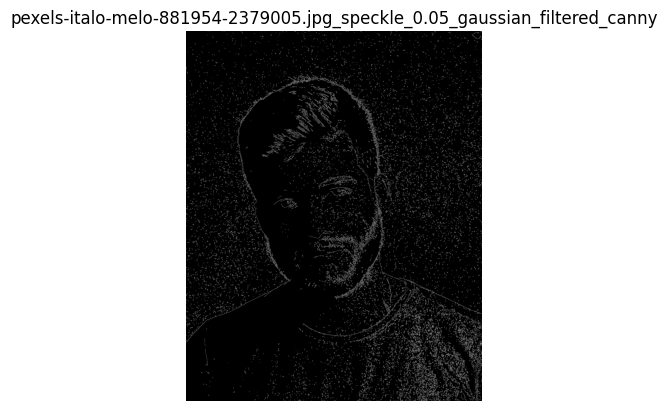

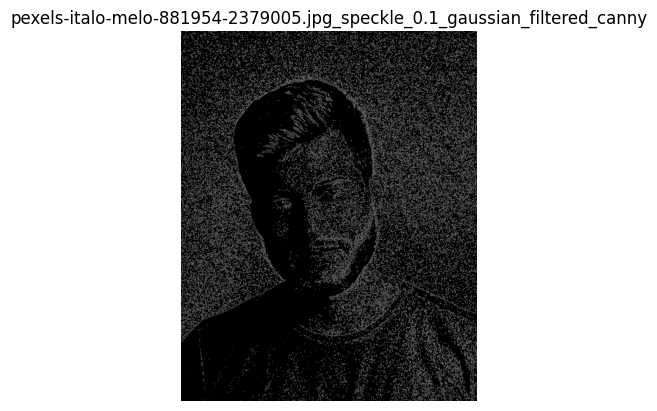

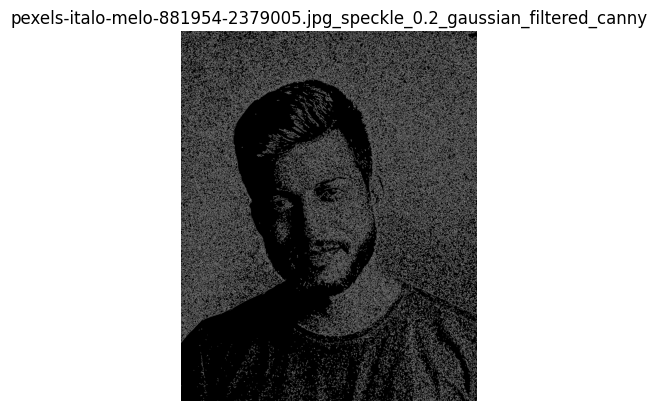

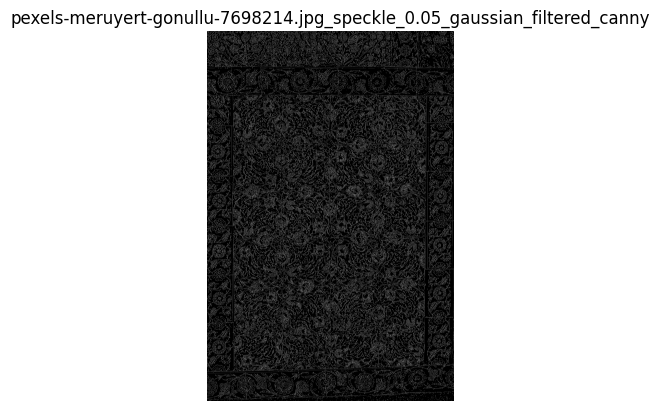

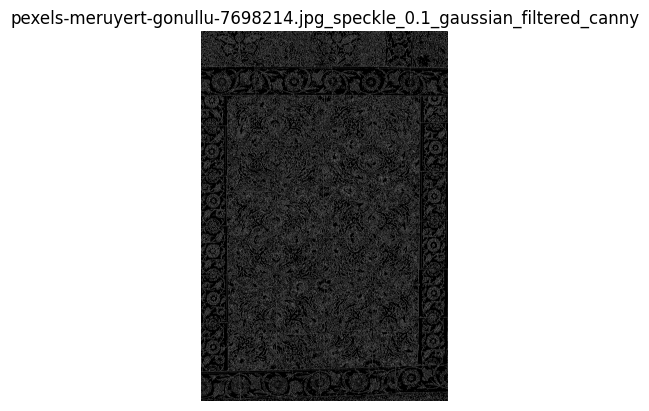

...

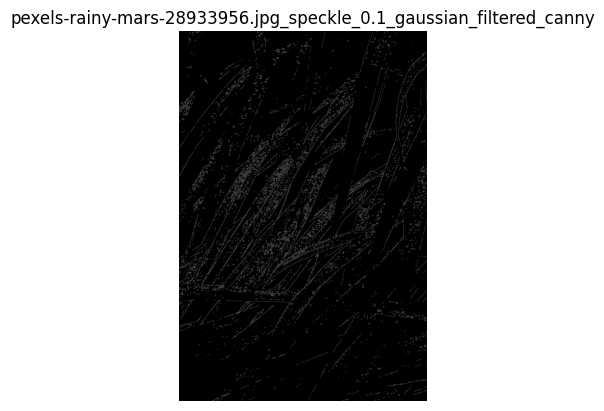

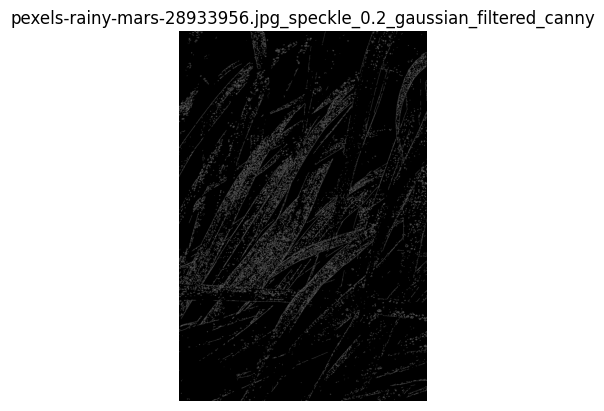

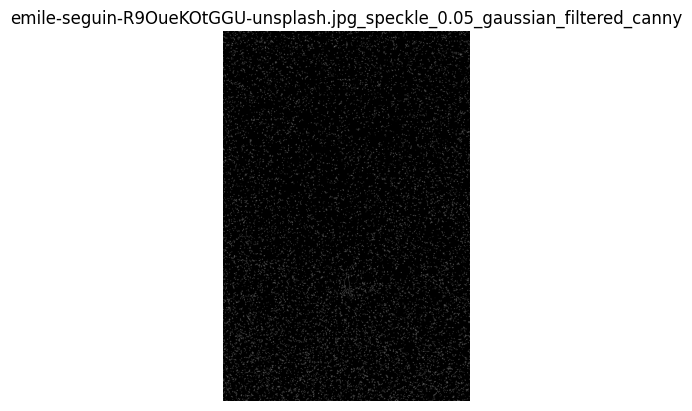

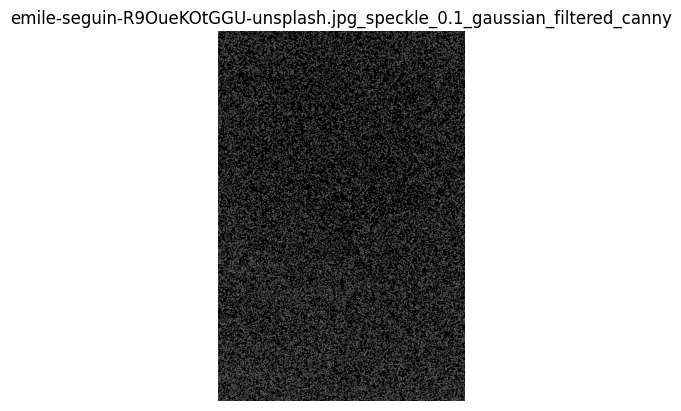

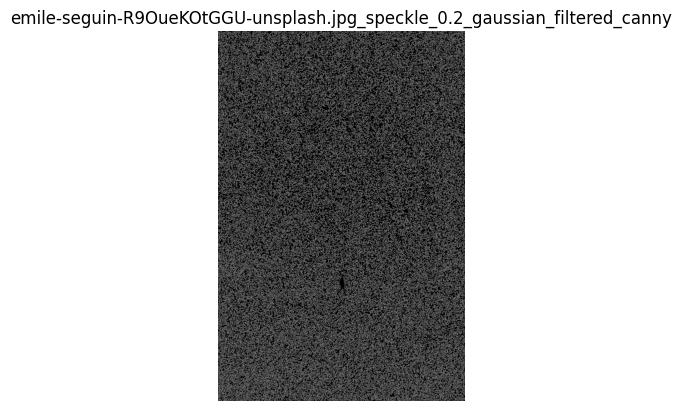

In [43]:
canny_data = []

for index, row in filtered_images.iterrows():
    canny_edges = apply_canny_edge(row['image'], threshold1=100, threshold2=200)
    canny_data.append({
        'filename': f"{row['filename']}_canny",
        'image': canny_edges
    })

canny_edges_df = pd.DataFrame(canny_data)

for index, row in canny_edges_df.iterrows():
    plt.imshow(row['image'], cmap='gray')
    plt.title(row['filename'])
    plt.axis('off')
    plt.show()

Too much of the noise was detected as edges, visualizing the faliur of the Medial filter of getting rid of the noise.

In [68]:
start_time = time.time()

filtered_data = []

for index, row in speckle_noise.iterrows():
    filtered_img = apply_median_filter(row['image'], ksize=11)
    filtered_data.append({
        'filename': f"{row['filename']}_gaussian_filtered",
        'image': filtered_img,
    })

end_time = time.time()

total_time = end_time - start_time
Computational_times["Speckle"].append(total_time)
print(f"Total computational time for applying Median filter: {total_time:.4f} seconds")

filtered_images = pd.DataFrame(filtered_data)

Total computational time for applying Median filter: 7.9149 seconds


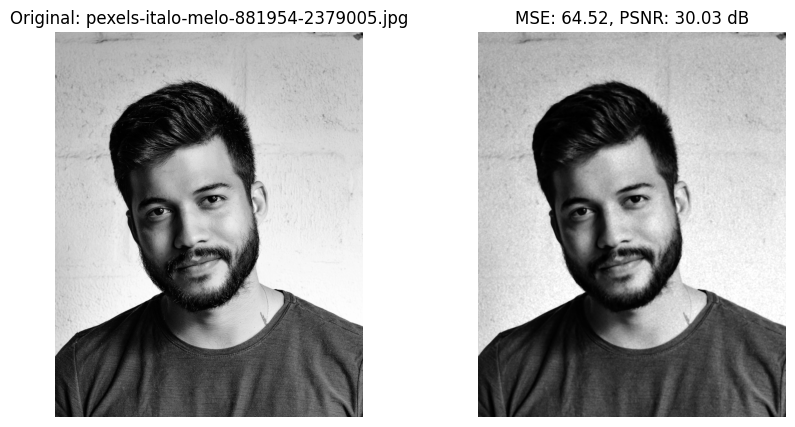

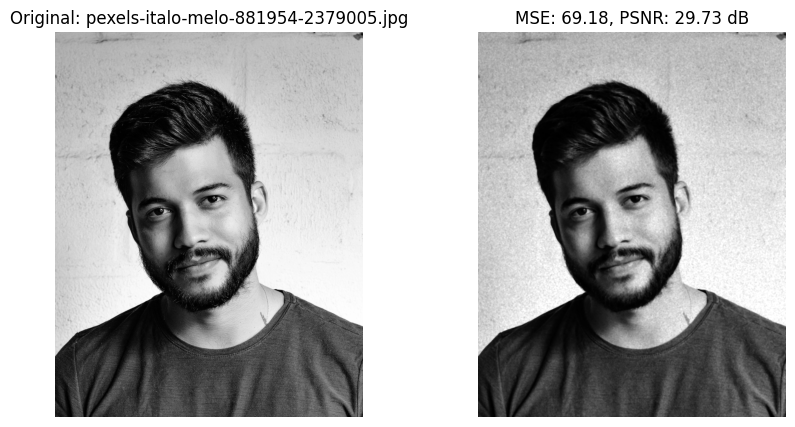

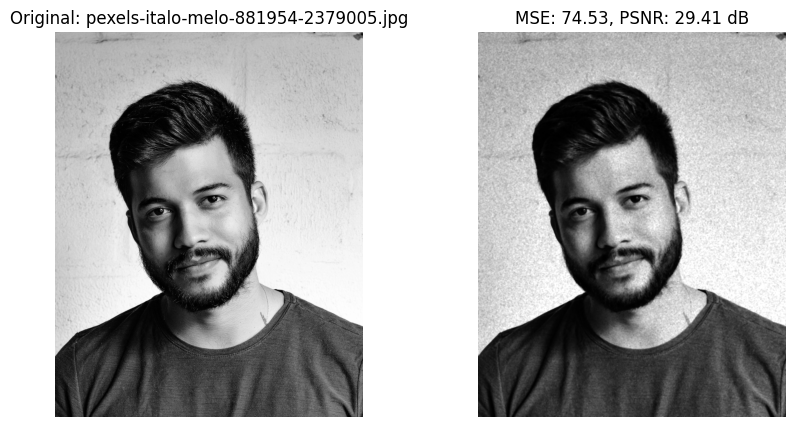

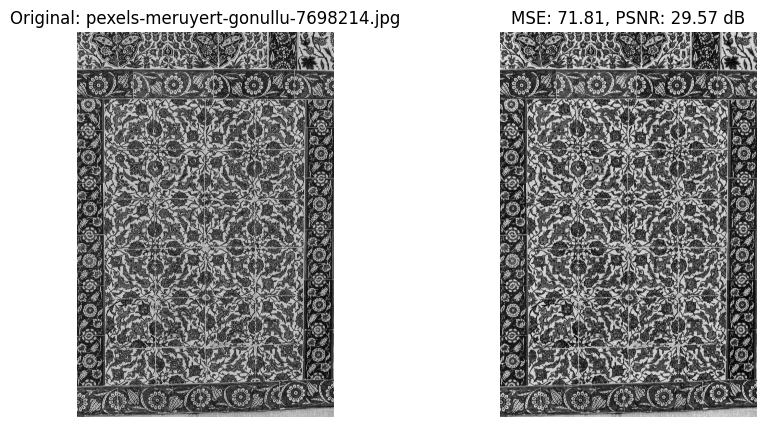

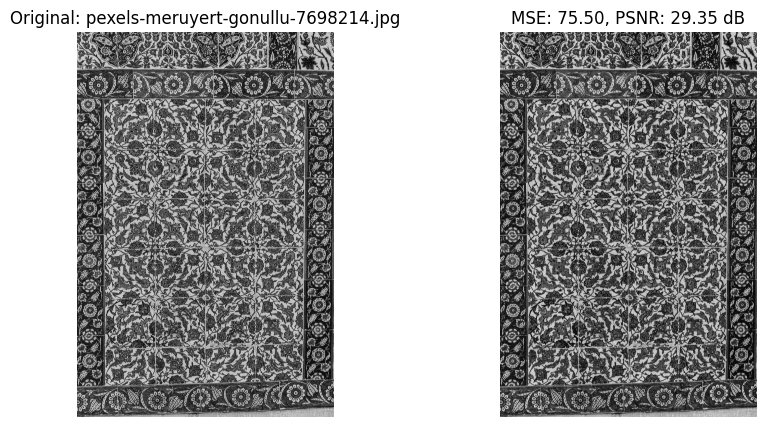

...

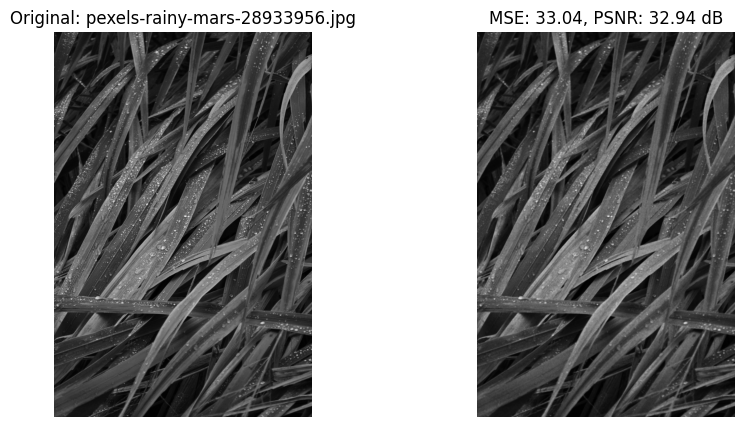

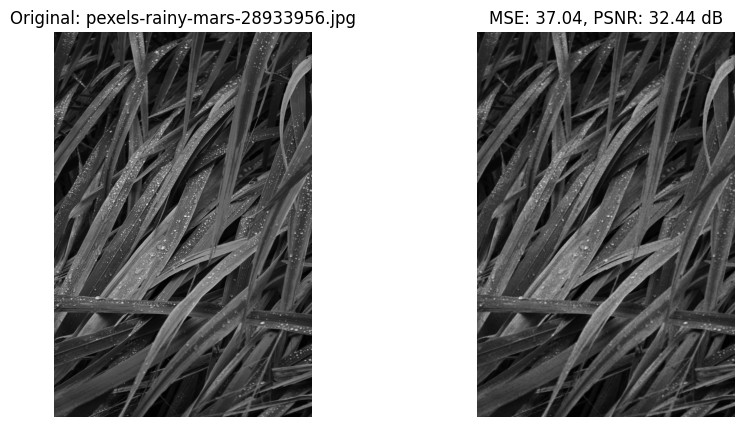

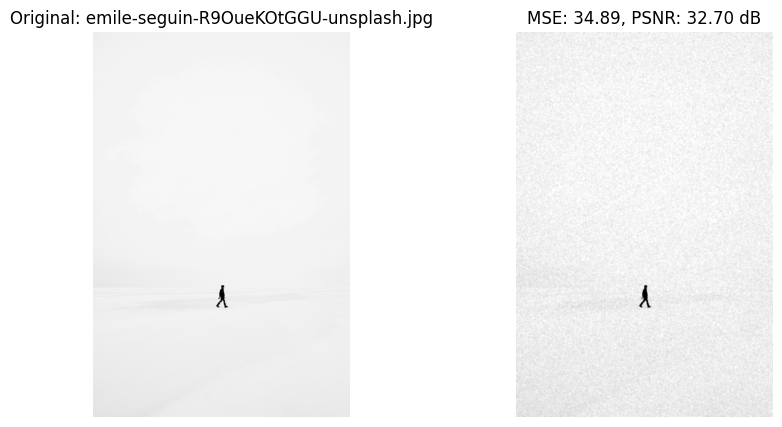

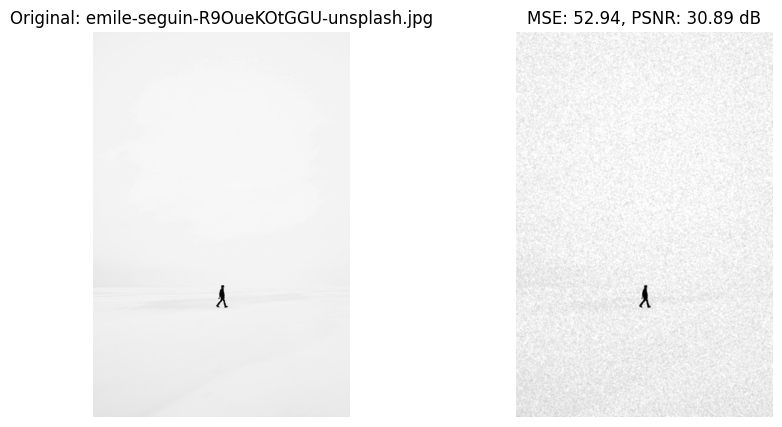

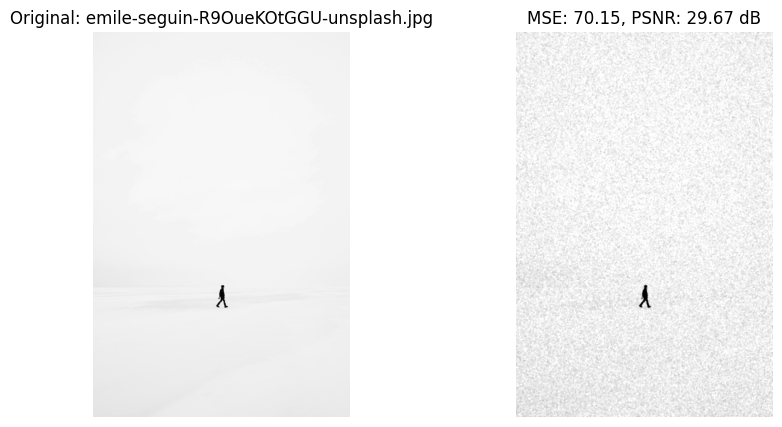

avarage mse = 57.738802901521744
avarage psnr = 30.768806164063847


In [69]:
counter = 0
mse_sum = 0
psnr_sum = 0

for index, row in original.iterrows():
    original_img = row['image']

    filtered_img_rows = filtered_images[filtered_images['filename'].str.contains(row['filename'])]

    for _, filtered_row in filtered_img_rows.iterrows():
        filtered_img = filtered_row['image']

        mse = calculate_mse(original_img, filtered_img)
        mse_sum += mse
        psnr = calculate_psnr(mse)
        psnr_sum += psnr

        counter +=1

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title(f"Original: {row['filename']}")
        axes[0].axis('off')

        axes[1].imshow(filtered_img, cmap='gray')
        axes[1].set_title(f"MSE: {mse:.2f}, PSNR: {psnr:.2f} dB")
        axes[1].axis('off')

        plt.show()

avrg_mse = mse_sum/counter
average_MSE["Speckle"].append(avrg_mse)
print(f"avarage mse = {avrg_mse}")

avrg_psnr = psnr_sum/counter
average_psnr["Speckle"].append(avrg_psnr)
print(f"avarage psnr = {avrg_psnr}")

With a bigger kernel the output was slightly better, with a somewhat smaller average MSE, and less noise visible. Still, the images weren't visually appealing.

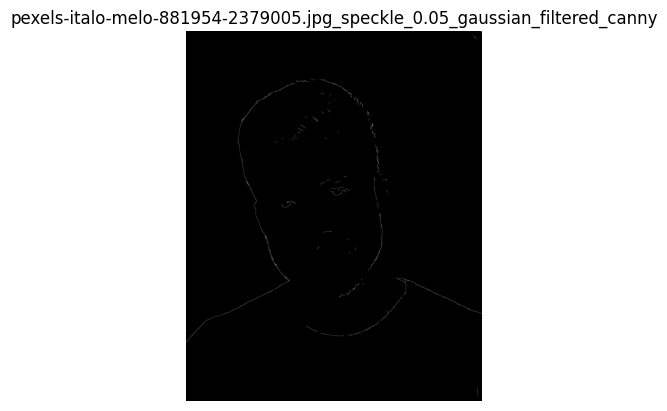

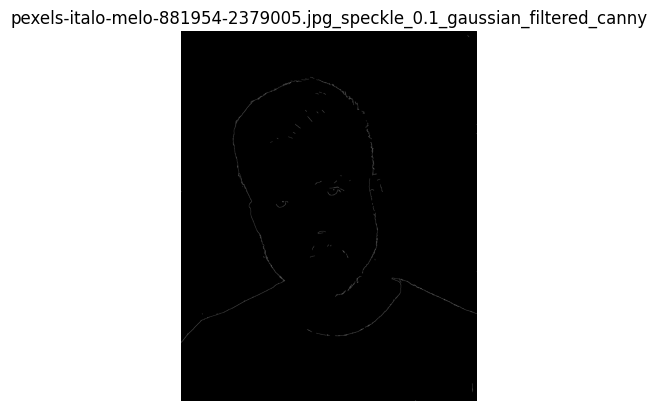

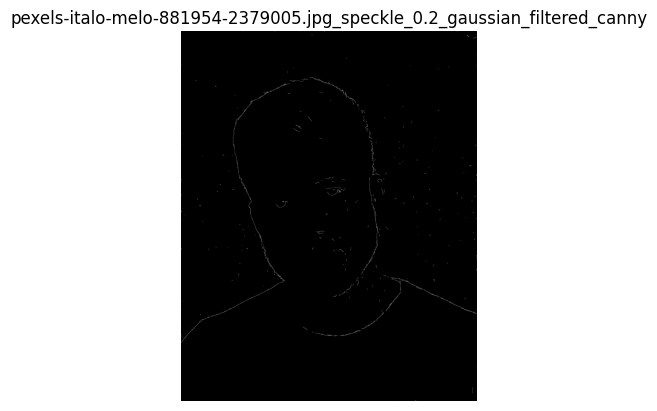

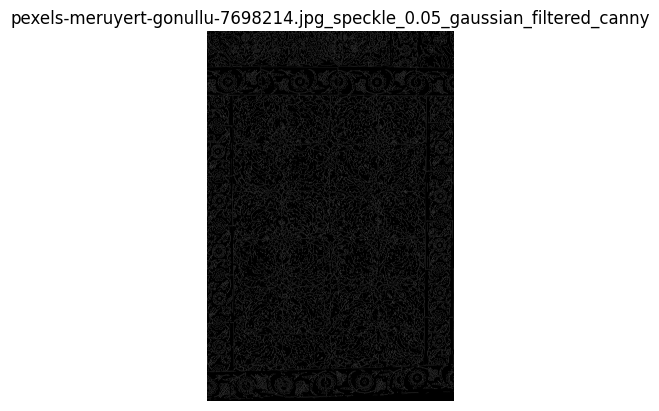

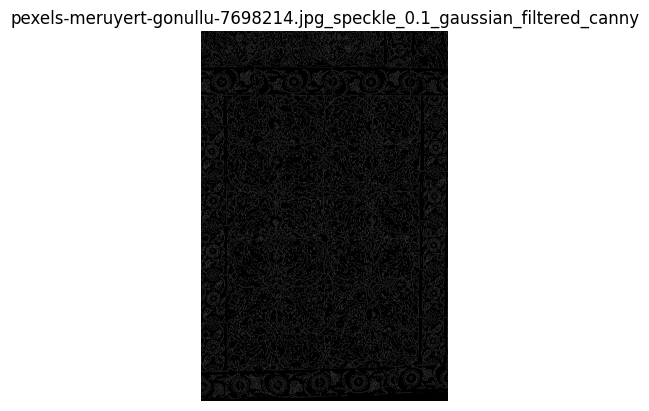

...

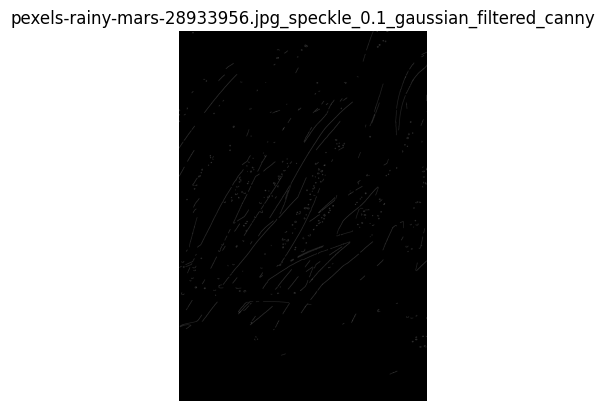

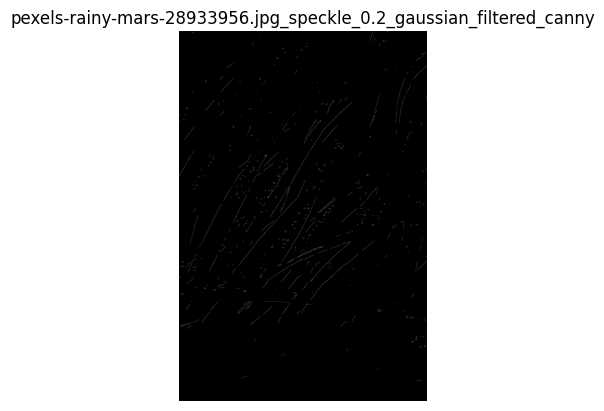

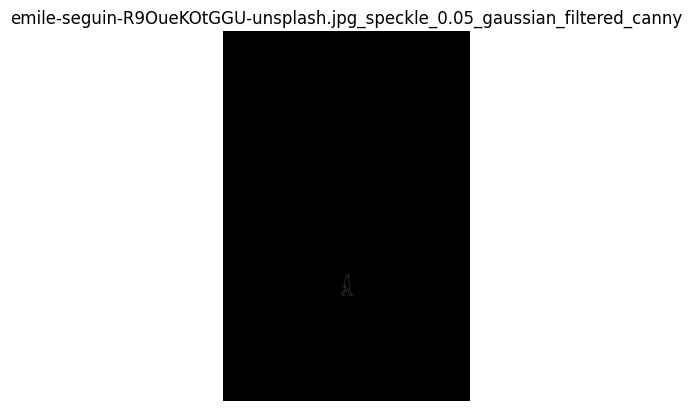

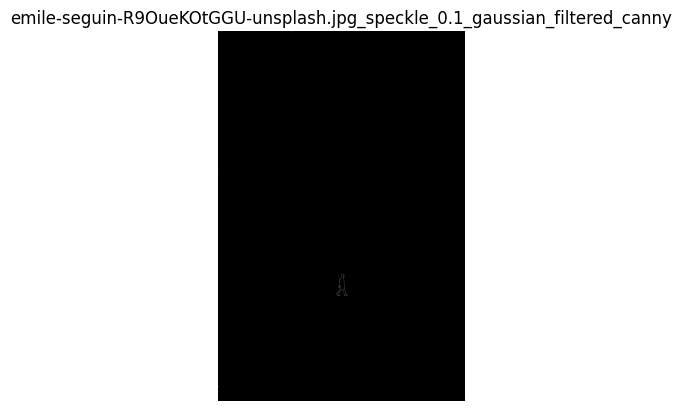

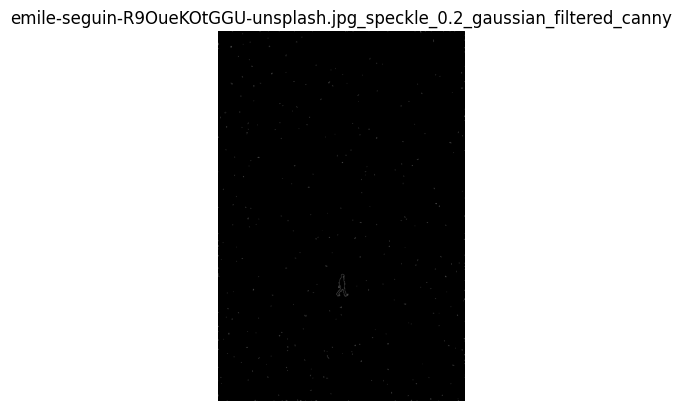

In [46]:
canny_data = []

for index, row in filtered_images.iterrows():
    canny_edges = apply_canny_edge(row['image'], threshold1=100, threshold2=200)
    canny_data.append({
        'filename': f"{row['filename']}_canny",
        'image': canny_edges
    })

canny_edges_df = pd.DataFrame(canny_data)

for index, row in canny_edges_df.iterrows():
    plt.imshow(row['image'], cmap='gray')
    plt.title(row['filename'])
    plt.axis('off')
    plt.show()

The bigger kernel helped a lot with preventing Canny from detecting noise as edges, as now only originally thick strong edges were detected. But of course weak edges were sacrificed.

# Results:

In [70]:
comp_times_df = pd.DataFrame(Computational_times, index=['Kernel N=5', 'Kernel N=11']).T
mse_df = pd.DataFrame(average_MSE, index=['Kernel N=5', 'Kernel N=11']).T
psnr_df = pd.DataFrame(average_psnr, index=['Kernel N=5', 'Kernel N=11']).T

In [71]:
print("Computational Times:")
comp_times_df.style.set_caption("Computational Times").set_table_styles([{'selector': 'th', 'props': [('border', '1px solid black')]}])

Computational Times:


,Kernel N=5,Kernel N=11
Salt and Pepper,0.550433,6.317608
Gaussian,0.485586,8.126738
Poisson,0.164723,2.231374
Speckle,0.511798,7.914862


A bigger kernel cost much higher computational time. As the bigger kernel filter had more pixels to solve their values than choosing the median. And sorting methods take computational time

In [73]:
print("Average MSEs:")
mse_df.style.set_caption("Average MSEs").set_table_styles([{'selector': 'th', 'props': [('border', '1px solid black')]}])

Average MSEs:


,Kernel N=5,Kernel N=11
Salt and Pepper,26.643885,35.424395
Gaussian,107.368240,111.034955
Poisson,47.833502,55.157664
Speckle,66.838534,57.738803


Average MSE got worse with bigger kernel sizes, as the noise got to be a majority in these kernels, and skewed the median toward them.

In [74]:
print("Average PSNRs:")
psnr_df.style.set_caption("Average PSNRs").set_table_styles([{'selector': 'th', 'props': [('border', '1px solid black')]}])

Average PSNRs:


,Kernel N=5,Kernel N=11
Salt and Pepper,38.375611,36.776838
Gaussian,27.828343,27.682999
Poisson,31.870186,31.000010
Speckle,30.140642,30.768806


Average PSNR didn't change with the change in kernel size. As the filter bridged the pixel values closer, away from outliers.